In [1]:
import sys # we require code from other folders
import pandas as pd
import numpy as np
import itertools
import pickle
import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
CB_color_cycle = ['#EECC16', '#62BB35', '#FDAE33','#208EA3', '#EA4E9D', '#984ea3','#999999', '#e41a1c', '#dede00']
#sns.set_style("darkgrid")

In [3]:
import matplotlib.font_manager as fm
font_files = fm.findSystemFonts()

plt.rcdefaults()
# Go through and add each to Matplotlib's font cache.
for font_file in font_files:
    fm.fontManager.addfont(font_file)
plt.rc('font', family='Roboto')

In [4]:
plt.rc('font', family='Roboto')

plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = 'Roboto'

In [5]:
#%config InlineBackend.figure_format='retina'

In [6]:
# pytorch relates imports
import torch
import torch.nn as nn
import torch.optim as optim

# imports from captum library
from captum.attr import LayerDeepLift

In [7]:
# for combobox
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

In [8]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

In [9]:
pd.options.display.min_rows = 20000
pd.set_option('max_colwidth', 200)

In [10]:
pd.options.display.max_rows = 20000

In [11]:
pd.set_option('min_rows', 20000)

In [12]:
mac = "/Users/katyna/Library/CloudStorage/OneDrive-Tecnun/"
windows = "C:/Users/ksada/OneDrive - Tecnun/"
computer = windows # CHANGE

In [13]:
sys.path.append(computer + "SparseGO_code/code")
import util
from util import *

In [14]:
%matplotlib inline

In [15]:
#%matplotlib inline

# To make histograms
def histogram(dataframe, color, title, ylabel,n_bins):
    N, bins, patches = plt.hist(dataframe, color=color,bins=n_bins, linewidth=0.1)

    for i in range(0,len(bins)-1):
        if bins[i]<0.05:
            patches[i].set_facecolor(CB_color_cycle[2])

    plt.xlabel("P-value", fontsize=16)  
    plt.ylabel(ylabel, fontsize=16)
    plt.title(title, fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14)
    ax = plt.subplot(111)  
    ax.spines["top"].set_visible(False)  
    ax.spines["right"].set_visible(False)    

In [16]:
inputdir = computer+"SparseGO_code/data/cross_validation_expression/allsamples/" # CHANGE
dir1=computer+"Tesis/Codigo/VariableImportance/"
dir2=computer+"SparseGO_code/results/weights&biases/Expression_MSE_all/" # CHANGE
resultsdir=dir2

In [17]:
gene2id = inputdir+"gene2ind.txt"
cell2id=inputdir+"cell2ind.txt"
drug2id=inputdir+"drug2ind.txt"
drug2fingerprint=inputdir+"drug2fingerprint.txt"
load=resultsdir+"last_model.pt"

onto = inputdir+"ontology.txt"  # CHANGE 
genotype=inputdir+"cell2expression.txt"  # CHANGE 

num_neurons_per_GO = 6 # CHANGE

# DeepLIFT

In [18]:
gene2id_mapping = load_mapping(gene2id)
dG, terms_pairs, genes_terms_pairs = load_ontology(onto, gene2id_mapping)
sorted_pairs, level_list, level_number = sort_pairs(genes_terms_pairs, terms_pairs, dG, gene2id_mapping)
layer_connections = pairs_in_layers(sorted_pairs, level_list, level_number) 

cell_features = np.genfromtxt(genotype, delimiter=',')
drug_features = np.genfromtxt(drug2fingerprint, delimiter=',')

drug2id_mapping = load_mapping(drug2id)
cell2id_mapping = load_mapping(cell2id)

num_genes = len(gene2id_mapping)
drug_dim = len(drug_features[0,:])

There are 15015 genes
There are 1 roots: GO:0008150
There are 4184 terms
There are 1 connected components


In [19]:
model = torch.load(load, map_location='cuda:%d' % 0)

In [20]:
model

sparseGO_nn(
  (genes_terms_sparse_linear_1): SparseLinearNew(
    in_features=15015, out_features=25104, bias=True, sparsity=0.0030196221878822263, connectivity=tensor([[    0,     1,     2,  ..., 23721, 23722, 23723],
            [    0,     0,     0,  ..., 15014, 15014, 15014]], device='cuda:0'), small_world=False
  )
  (genes_terms_tanh): Tanh()
  (genes_terms_batchnorm): BatchNorm1d(25104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (GO_terms_sparse_linear_1): SparseLinearNew(
    in_features=25104, out_features=8304, bias=True, sparsity=0.002372788160788691, connectivity=tensor([[  966,   967,   968,  ...,  7047,  7048,  7049],
            [    0,     0,     0,  ..., 25103, 25103, 25103]], device='cuda:0'), small_world=False
  )
  (GO_terms_tanh_1): Tanh()
  (GO_terms_batchnorm_1): BatchNorm1d(8304, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (GO_terms_sparse_linear_2): SparseLinearNew(
    in_features=8304, out_features=3684, bias=True

In [21]:
# Save layers to be analyzed
model_layers = []
model_layers.append(model.genes_terms_sparse_linear_1)
model_layers.append(model.GO_terms_sparse_linear_1)
model_layers.append(model.GO_terms_sparse_linear_2)
model_layers.append(model.GO_terms_sparse_linear_3)
model_layers.append(model.GO_terms_sparse_linear_4)
model_layers.append(model.GO_terms_sparse_linear_5)
model_layers.append(model.GO_terms_sparse_linear_6)
model_layers.append(model.GO_terms_sparse_linear_7)

## GO terms info

In [22]:
# Go term names
gene_ontology = pd.read_excel('all_go_terms_info.xlsx')

Get all layers' GO term with the neuron number

In [23]:
all_terms_ids = {}
all_terms_names = {}
all_layers_non_virtual = {} # store only terms that are part of the layer (remove virtual), those are the important attribuitions
all_layers_non_virtual_names = {}
num_neurons_per_GO = 6

for layer_number in range(len(layer_connections)-1):
    layer_pairs = layer_connections[layer_number] 
    
    terms_ids = []
    names = []
    output_id = create_index(layer_pairs[:,0]) # first 6 neurons correspond to the term with key 0
    
    for term in output_id.keys():
        #name = gene_ontology.loc[gene_ontology['GO_term'] == term].to_numpy()[0,3].replace("_"," ").capitalize()
        name = gene_ontology.loc[gene_ontology['id'] == term].to_numpy()[0,1].capitalize()
        for i in range(1,num_neurons_per_GO+1): # vector que tiene GO:0000038_1, GO:0000038_2 ... GO:0000038_6 y asi luego concatenar con las attributions
            terms_ids.append(term+"_"+str(i))
            names.append(name+" ("+str(i)+")")
    all_terms_ids[layer_number] = np.array(terms_ids)
    all_terms_names[layer_number] = np.array(names)

    non_virtual = [] # store the terms part of that layer
    non_virtual_names = []
    for term in level_list[layer_number+1]:
        nv_name = gene_ontology.loc[gene_ontology['id'] == term].to_numpy()[0,1].capitalize()
        for i in range(1,7):
            non_virtual.append(term+"_"+str(i))
            non_virtual_names.append(nv_name+" ("+str(i)+")")
    all_layers_non_virtual[layer_number] = non_virtual
    all_layers_non_virtual_names[layer_number] = non_virtual_names

All GO terms part of a layer (non-virtual) with their corresponding name and layer number...

In [24]:
real_go_info = pd.DataFrame({"GO_term":[],"Name":[],"layer_number":[]})
for layer_number in range(len(layer_connections)-1):
    layer_go_info = pd.DataFrame({"GO_term":all_layers_non_virtual[layer_number],"Name":all_layers_non_virtual_names[layer_number],"layer_number":(layer_number)})
    real_go_info = pd.concat((real_go_info,layer_go_info))
real_go_info.head()

,GO_term,Name,layer_number
0,GO:0000019_1,Regulation of mitotic recombination (1),0.0
1,GO:0000019_2,Regulation of mitotic recombination (2),0.0
2,GO:0000019_3,Regulation of mitotic recombination (3),0.0
3,GO:0000019_4,Regulation of mitotic recombination (4),0.0
4,GO:0000019_5,Regulation of mitotic recombination (5),0.0


## Drugs info

In [25]:
def get_compound_names(file_name):
    compounds = []

    with open(file_name, 'r') as fi:
        for line in fi:
            tokens = line.strip().split('\t')
            compounds.append([tokens[1],tokens[2]])
    return compounds

In [26]:
drugs = get_compound_names(inputdir+"compound_names.txt")
drugs.pop(0)

['SMILE', 'Name']

## DeepLIFT for VNN

*Reference activation...* (baseline)

In [27]:
median_cell_features = np.median(cell_features,axis=0) # to use as a reference
median_drug_features = np.genfromtxt(computer+"SparseGO_code/data/glucose_fingerprint.txt", delimiter=',')


### Attribution function: sum

In [28]:
def get_layer_attribution(layer_number,input_data,baseline,selected_drug_data):
    dl = LayerDeepLift(model, model_layers[layer_number],multiply_by_inputs = True) # CHOOSE LAYER TO STUDY
    dl_attr_test = dl.attribute(input_data,baseline)
    dl_attr_test_sum = dl_attr_test.cpu().detach().numpy().sum(0) # se suman las attributions para cada sample
    
    attribution_data = pd.DataFrame(np.column_stack((all_terms_ids[layer_number],dl_attr_test_sum)), columns=["GO_term",selected_drug_data[1]])
    attribution_data[[selected_drug_data[1]]] = attribution_data[[selected_drug_data[1]]].apply(pd.to_numeric).round(10)
    attribution_data = attribution_data.loc[attribution_data['GO_term'].isin(all_layers_non_virtual[layer_number])] # only the keep the non virtual terms
    return attribution_data

### DeepLIFT for all drugs

In [ ]:
attribution_data_all = pd.DataFrame()
# Obtain the top GO terms on all layers for each drug
for selected_drug_data in drugs:
    selected_drug =selected_drug_data[0] # DRUG smile
    selected_drug_features = []
    drug_specific_features=drug_features[drug2id_mapping[selected_drug]] # features of drug
    
    for i in range(len(cell2id_mapping)): # make all combinations of selected_drug and cell types 
        selected_drug_features.append(np.concatenate((cell_features[i], drug_specific_features), axis=None))
    selected_drug_features = torch.FloatTensor(np.array(selected_drug_features))

    # Data for deeplift...
    input_data = torch.autograd.Variable(selected_drug_features.cuda(0))
    
    #median_drug_features = drug_specific_features
    # baseline is the median of the expression data and drug features 
    baseline = torch.FloatTensor(np.concatenate((median_cell_features, median_drug_features), axis=None))
    baseline = torch.reshape(baseline, (1, baseline.size()[0]))
    baseline = torch.autograd.Variable(baseline.cuda(0))
    
    attribution_data_drug = list(map(get_layer_attribution,range(0,len(model_layers)),itertools.repeat(input_data, len(model_layers)),itertools.repeat(baseline, len(model_layers)),itertools.repeat(selected_drug_data, len(model_layers)))) # get the attribution for each layer (map is similar to apply)
    attribution_data_drug = pd.concat(attribution_data_drug) # concatenate attribution of all layers
    
    attribution_data_all = pd.concat([attribution_data_all,attribution_data_drug.iloc[:,1]], axis=1)
    
    print(selected_drug_data[1])
    
attribution_data_all = pd.concat([attribution_data_drug.iloc[:,0],attribution_data_all], axis=1)

In [30]:
attribution_data_all = attribution_data_all.set_index("GO_term")

In [31]:
attribution_data_all.head()

,BRD-K02251932-001-01-3,BRD-K25737009-001-01-2,Nintedanib,bicalutamide,"N-[(2R,3S)-2-[[cyclopropylmethyl(methyl)amino]methyl]-5-[(2R)-1-hydroxypropan-2-yl]-3-methyl-6-oxo-3,4-dihydro-2H-1,5-benzoxazocin-8-yl]-1-methyl-4-imidazolesulfonamide",PHA-665752,N-cyclopropyl-3-[3-[[cyclopropyl(oxo)methyl]amino]-1H-indazol-6-yl]benzamide,Ki8751,IPA-3,FAWUGYGEBHAQBU-PPEXNQRJSA-N,...,ML031,Semagacestat,RITA,CDK9 inhibitor,Dasatinib,BMS-536924;CC1=CC(=CC2=C1NC(=C3C(=CC=NC3=O)NC[C@H](C4=CC(=CC=C4)Cl)O)N2)N5CCOCC5,SCHEMBL13741284,Daporinad,STF-31,Narciclasine
GO_term,,,,,,,,,,,,,,,,,,,,,
GO:0000012_1,-0.006564,-0.005680,0.003188,-0.005863,-0.003410,-0.002951,0.001118,0.002033,0.000799,-0.007842,...,-0.007256,-0.004271,-0.013783,-0.006253,0.002864,0.009604,-0.008099,-0.001475,-0.003698,-0.009866
GO:0000012_2,0.010029,0.011514,0.009892,0.012072,0.005788,0.012909,0.002316,0.009362,-0.011816,0.000166,...,0.008918,-0.002449,0.017704,0.006732,0.002447,0.006485,0.003888,-0.000569,0.001628,0.017132
GO:0000012_3,0.008466,0.006840,-0.000027,0.006379,0.003082,-0.006110,-0.008877,-0.000347,-0.013084,0.000150,...,-0.006096,0.011308,0.012216,0.000997,0.011521,0.013800,0.002843,0.016328,0.021640,0.003536
GO:0000012_4,0.013018,0.007276,0.010128,0.008622,0.004795,0.006706,0.000874,0.005514,-0.003347,-0.000010,...,-0.003682,0.006544,0.010806,0.003346,0.017556,0.023130,0.001105,0.009710,0.016940,0.014787
GO:0000012_5,-0.007076,-0.006129,-0.007634,-0.003785,-0.004151,-0.007947,-0.008430,-0.006039,-0.002722,0.002163,...,0.001821,-0.002346,-0.007831,-0.009368,-0.011118,-0.003408,-0.001760,0.003593,-0.000109,-0.020831


# ChEMBL Drug Target Slim

In [32]:
from chembl_webresource_client.new_client import new_client

Import SparseGO drugs

In [ ]:
# Get names 
def get_compound_names(file_name):
    compounds = []

    with open(file_name, 'r') as fi:
        for line in fi:
            tokens = line.strip().split('\t')
            compounds.append(tokens[2].lower())

    return compounds
names = get_compound_names(computer+"SparseGO_code/data/compound_names.txt")
names.pop(0)

## chEML IDs

Get chembl IDs of drugs if available (there are always 684 drugs, the compounds2ids object can be reused)

In [ ]:
# Get all chembl IDs -- tarda
molecule = new_client.molecule

compounds2ids = {}
for i,drug in enumerate(names):
    
    if " + " in drug:
        drug_split = drug.split(" + ", 1)
        ID1 = list(molecule.filter(pref_name__iexact=drug_split[0]).only('molecule_chembl_id'))
        ID2 = list(molecule.filter(pref_name__iexact=drug_split[1]).only('molecule_chembl_id'))
        if len(ID1)>0 and len(ID2)>0:
            compounds2ids[drug]=[ID1[0]['molecule_chembl_id'],ID2[0]['molecule_chembl_id']]
        elif len(ID1)>0:
            compounds2ids[drug]=ID1[0]['molecule_chembl_id'] 
        elif len(ID2)>0:
            compounds2ids[drug]=ID2[0]['molecule_chembl_id'] 
        else:
            print(drug,i)

    else:
        ID = list(molecule.filter(pref_name__iexact=drug).only('molecule_chembl_id'))
        if len(ID)>0:
            ID = ID[0]['molecule_chembl_id']
            compounds2ids[drug]=ID
        else:
            # for drugs that have the chembl ID as the name!!
            ID = list(molecule.filter(chembl_id=drug).only('molecule_chembl_id')) 
            if len(ID)>0:
                ID = ID[0]['molecule_chembl_id']
                compounds2ids[drug]=ID
            else:
                # in case it is not found by pref_name
                ID = list(molecule.filter(molecule_synonyms__molecule_synonym__iexact=drug).only('molecule_chembl_id'))
                if len(ID)>0:
                    ID = ID[0]['molecule_chembl_id']
                    compounds2ids[drug]=ID
                else:
                    print(drug,i)
    # 341 chembl IDs where found (october 31 2022)

In [35]:
#manually add 6 more
compounds2ids["teniposide [usan]"]="CHEMBL452231"
compounds2ids["docetaxel (taxotere)"]="CHEMBL92"
compounds2ids["nan + navitoclax(1)"]="CHEMBL443684"
compounds2ids["nan + navitoclax(2)"]="CHEMBL443684"
compounds2ids["osi-027;coc1=cc=cc2=cc(=c3c4=c(n=cnn4c(=n3)c5ccc(cc5)c(=o)o)n)n=c21"]="CHEMBL3120215"
compounds2ids["paclitaxel;cc1=c2[c@h](c(=o)[c@@]3([c@h](c[c@@h]4[c@]([c@h]3[c@@h]([c@@](c2(c)c)(c[c@@h]1oc(=o)[c@@h]([c@h](c5=cc=cc=c5)nc(=o)c6=cc=cc=c6)o)o)oc(=o)c7=cc=cc=c7)(co4)oc(=o)c)o)c)oc(=o)c"]="CHEMBL428647"

In [36]:
len(compounds2ids)

347

## chEMBL MoA (targets)

Get the molecule targets of each drug (if available)

In [ ]:
compounds2targets = dict() # required to store the drug targets 
for drug in compounds2ids.keys():
    compounds2targets[drug] = set()

chembl_ids = list(compounds2ids.values()) # Chembl IDs of drugs

for drug in compounds2ids:
    # we jump from compounds to targets through activities:
    activities = new_client.mechanism.filter(parent_molecule_chembl_id__in=compounds2ids[drug]).only(
        ['parent_molecule_chembl_id', 'target_chembl_id'])
    # extracting target ChEMBL IDs from activities:
    for act in activities:
        compounds2targets[drug].add(act['target_chembl_id'])
    print(drug)
# We now know all targets for some drug

In [38]:
compounds2targets = {k: v for k, v in compounds2targets.items() if len(v) != 0 and len([x for x in list(v) if x is not None]) != 0 }
# 218 DRUGS HAVE ANNOTATED DRUG TARGETS

In [39]:
len(compounds2targets)

220

## Drug slim GO terms

Get the GO terms of each target

In [ ]:
# Get the GO terms of each target
compounds_GOterms = {}
for i in range(0, len(compounds2targets.keys())):
    compound = list(compounds2targets.keys())[i]
    GOterms_list = []
    
    for j in range(0, len(list(compounds2targets[compound]))):   
        target = list(compounds2targets[compound])[j]
        all_cross_references = list(new_client.target.filter(target_chembl_id=target).only(['target_components']).only(['target_components_xrefs']))[0]['target_components']
        if len(all_cross_references)>0: # not all targets have annotated go_terms
            for i in range(0, len(all_cross_references)):
                GOterms = all_cross_references[i]
                GOterms = pd.DataFrame(GOterms['target_component_xrefs'])
                GOterms = pd.concat([GOterms,pd.Series([target]).repeat(len(GOterms)).reset_index().pop(0)],axis=1) # add target ID to dataframe 
                GOterms_list= GOterms_list + GOterms.values.tolist()
    
    compounds_GOterms[compound] =  pd.DataFrame(GOterms_list).drop_duplicates()
    print(compound)

In [41]:
len(compounds_GOterms)

220

In [42]:
# we have 206 annotated drugs on CHEMBL

In [43]:
# add GO terms found in CTRPv2

In [46]:
CTRPv2_terms = pd.read_excel('ctrp_goterms_drugs.xlsx')  

In [47]:
# add GO terms of drugs with or without annotations
for drug in CTRPv2_terms["Drug"].unique():
    if drug not in list(compounds_GOterms.keys()): # some drugs had no previous data, no annotations from chembl
        compounds_GOterms[drug] = pd.DataFrame() # create empty dataframe

    for term in list(CTRPv2_terms.loc[CTRPv2_terms["Drug"]==drug]["Field"]):
        compounds_GOterms[drug] = pd.concat([compounds_GOterms[drug],pd.DataFrame([term,"","GoProcess",""]).transpose()])
    compounds_GOterms[drug] = compounds_GOterms[drug].drop_duplicates() 

# now we have 233 annotated drugs

In [48]:
# Delete drugs with no GOterms (some targets have no annotated GO terms)
compounds_GOterms = {k: v for k, v in compounds_GOterms.items() if len(v) != 0 } 

In [49]:
len(compounds_GOterms)

236

## Match GO terms

Find all terms that match, terms that are part of both, the sparseGO graph and the drug slim results... 

In [50]:
def load_ontology_extra_output(ontology_file, gene2id_mapping):
    """
    Creates the directed graph of the GO terms and stores the connected elements in arrays.

        Output
        ------
        dG: networkx.classes.digraph.DiGraph
            Directed graph of all terms

        terms_pairs: numpy.ndarray
            Store the connection between a term and a term

        genes_terms_pairs: numpy.ndarray
            Store the connection between a gene and a term
    """

    dG = nx.DiGraph() # Directed graph class

    file_handle = open(ontology_file) #  Open the file that has genes and go terms

    terms_pairs = [] # store the pairs between a term and a term
    genes_terms_pairs = [] # store the pairs between a gene and a term

    gene_set = set() # create a set (elements can't repeat)
    term_direct_gene_map = {}
    term_size_map = {}


    for line in file_handle:

        line = line.rstrip().split() # delete spaces and transform to list, line has 3 elements

        # No me hace falta el if, no tengo que separar las parejas
        if line[2] == 'default': # si el tercer elemento es default entonces se conectan los terms en el grafo
            dG.add_edge(line[0], line[1]) # Add an edge between line[0] and line[1]
            terms_pairs.append([line[0], line[1]]) # Add the pair to the list
        else:
            if line[1] not in gene2id_mapping: # se salta el gen si no es parte de los que estan en gene2id_mapping
                print(line[1])
                continue

            genes_terms_pairs.append([line[0], line[1]]) # add the pair

            if line[0] not in term_direct_gene_map: # si el termino todavia no esta en el diccionario lo agrega
                term_direct_gene_map[ line[0] ] = set() # crea un set

            term_direct_gene_map[line[0]].add(gene2id_mapping[line[1]]) # añadimos el gen al set de ese term

            gene_set.add(line[1]) # añadimos el gen al set total de genes

    terms_pairs = np.array(terms_pairs) # convert to 2d array
    genes_terms_pairs = np.array(genes_terms_pairs) # convert to 2d array

    file_handle.close()

    print('There are', len(gene_set), 'genes')

    for term in dG.nodes(): # hacemos esto para cada uno de los GO terms

        term_gene_set = set() # se crea un set

        if term in term_direct_gene_map:
            term_gene_set = term_direct_gene_map[term] # genes conectados al term

        deslist = nxadag.descendants(dG, term) #regresa todos sus GO terms descendientes (biological processes tiene 2085 descendientes, todos menos el mismo)

        for child in deslist:
            if child in term_direct_gene_map: # añadir los genes de sus descendientes
                term_gene_set = term_gene_set | term_direct_gene_map[child] # union of both sets, ahora tiene todos los genes los suyos y los de sus descendientes

        if len(term_gene_set) == 0:
            print('There is empty terms, please delete term:', term)
            sys.exit(1)
        else:
            # por ahora esta variable no me hace falta
            term_size_map[term] = len(term_gene_set) # cantidad de genes en ese term  (tomando en cuenta sus descendientes)

    leaves = [n for n in dG.nodes if dG.in_degree(n) == 0] # buscar la raiz
    #leaves = [n for n,d in dG.in_degree() if d==0]

    uG = dG.to_undirected() # Returns an undirected representation of the digraph
    connected_subG_list = list(nxacc.connected_components(uG)) #list of all GO terms

    # Verify my graph makes sense...
    print('There are', len(leaves), 'roots:', leaves[0])
    print('There are', len(dG.nodes()), 'terms')
    print('There are', len(connected_subG_list), 'connected components')
    if len(leaves) > 1:
        print('There are more than 1 root of ontology. Please use only one root.')
        sys.exit(1)
    if len(connected_subG_list) > 1:
        print( 'There are more than connected components. Please connect them.')
        sys.exit(1)

    return dG, terms_pairs, genes_terms_pairs, term_direct_gene_map, term_size_map


### SparseGO graph 

In [51]:
# Import SparseGO graph (to extract all nodes/terms)... 

# Load ontology: create the graph of connected GO terms
dG, terms_pairs, genes_terms_pairs, term_direct_gene_map, term_size_map = load_ontology_extra_output(onto, gene2id_mapping)
####
sparseGO_terms = list(dG.nodes())
sparseGO_terms.remove("GO:0008150")

There are 15015 genes
There are 1 roots: GO:0008150
There are 4184 terms
There are 1 connected components


### Full GO graph

In [52]:
# Import full graph (to find parents)...
import obonet
#import networkx as nx
url = 'http://purl.obolibrary.org/obo/go/go-basic.obo'
full_graph = obonet.read_obo(url)
full_graph = full_graph.reverse() # change the direction of nodes
[n for n in full_graph.nodes if full_graph.in_degree(n) == 0] # graph contains the 3 roots (BP,MF,CC)

['GO:0003674', 'GO:0005575', 'GO:0008150']

### Match terms!

Find all terms that match, terms that are part of both, the sparseGO graph and the drug slim results... if the slim terms' ascendants are a match, they are also added 

In [ ]:
# Each model has DIFFERENT matches (the graph is different)
compounds_GOterms_matches = {}
for drug in compounds_GOterms.keys():
    # choose drug
    drug_df = compounds_GOterms[drug]
    drug_slim_GOterms = set(drug_df.loc[drug_df[2] == "GoProcess"][0]) # only GO processes
    #set(sparseGO_terms) & set(drug_slim_GOterms)
    drug_matches = [] # store all directly matched terms and matches with all parents
    for term in drug_slim_GOterms: # term ='GO:1902669' # buen ejemplo 
        
        if term in sparseGO_terms: # is the term in the sparseGO terms? 
            drug_matches.append([1,term]) # add to list
            #1: same term, 2:not direct match  (esto igual despues...the number indicates how direct is the relationship 0:same term, 1: parent, 2: grandpa, 3:...)
        
        # are its ascendants in the sparseGO terms? 
        parents = [source for source, _ in  full_graph.in_edges(term)] # parents of term
        relationship = 2
        while(len(parents)>0): # check all ascendants 
            #relationship+=1
            parents = [source for source, _ in  full_graph.in_edges(parents)] # parents of parents
        
            for parent_term in parents: # add parents that match sparseGO terms 
                if parent_term in sparseGO_terms:
                    drug_matches.append([relationship, parent_term])
        
        drug_matches = (pd.DataFrame(drug_matches).drop_duplicates()).values.tolist() # remove duplicates
        compounds_GOterms_matches[drug] = drug_matches
    print(drug)

In [54]:
# delete drugs that have no matches
compounds_GOterms_matches = {i:j for i,j in compounds_GOterms_matches.items() if j != []}

In [55]:
len(compounds_GOterms_matches)

230

## SparseGO terms x drugSlim terms matrix 

In [66]:
attribution_data_all.columns = attribution_data_all.columns.str.lower() # in order to match the term

In [67]:
attribution_data_all.head()

,brd-k02251932-001-01-3,brd-k25737009-001-01-2,nintedanib,bicalutamide,"n-[(2r,3s)-2-[[cyclopropylmethyl(methyl)amino]methyl]-5-[(2r)-1-hydroxypropan-2-yl]-3-methyl-6-oxo-3,4-dihydro-2h-1,5-benzoxazocin-8-yl]-1-methyl-4-imidazolesulfonamide",pha-665752,n-cyclopropyl-3-[3-[[cyclopropyl(oxo)methyl]amino]-1h-indazol-6-yl]benzamide,ki8751,ipa-3,fawugygebhaqbu-ppexnqrjsa-n,...,ml031,semagacestat,rita,cdk9 inhibitor,dasatinib,bms-536924;cc1=cc(=cc2=c1nc(=c3c(=cc=nc3=o)nc[c@h](c4=cc(=cc=c4)cl)o)n2)n5ccocc5,schembl13741284,daporinad,stf-31,narciclasine
GO_term,,,,,,,,,,,,,,,,,,,,,
GO:0000012_1,-0.006564,-0.005680,0.003188,-0.005863,-0.003410,-0.002951,0.001118,0.002033,0.000799,-0.007842,...,-0.007256,-0.004271,-0.013783,-0.006253,0.002864,0.009604,-0.008099,-0.001475,-0.003698,-0.009866
GO:0000012_2,0.010029,0.011514,0.009892,0.012072,0.005788,0.012909,0.002316,0.009362,-0.011816,0.000166,...,0.008918,-0.002449,0.017704,0.006732,0.002447,0.006485,0.003888,-0.000569,0.001628,0.017132
GO:0000012_3,0.008466,0.006840,-0.000027,0.006379,0.003082,-0.006110,-0.008877,-0.000347,-0.013084,0.000150,...,-0.006096,0.011308,0.012216,0.000997,0.011521,0.013800,0.002843,0.016328,0.021640,0.003536
GO:0000012_4,0.013018,0.007276,0.010128,0.008622,0.004795,0.006706,0.000874,0.005514,-0.003347,-0.000010,...,-0.003682,0.006544,0.010806,0.003346,0.017556,0.023130,0.001105,0.009710,0.016940,0.014787
GO:0000012_5,-0.007076,-0.006129,-0.007634,-0.003785,-0.004151,-0.007947,-0.008430,-0.006039,-0.002722,0.002163,...,0.001821,-0.002346,-0.007831,-0.009368,-0.011118,-0.003408,-0.001760,0.003593,-0.000109,-0.020831


In [68]:
attribution_data_all.shape

(25098, 684)

Only keep drugs that have annotated GO terms

In [69]:
attribution_data_annotated = attribution_data_all[list(compounds_GOterms_matches.keys())]

In [70]:
attribution_data_annotated.shape # 230 DRUGS

(25098, 230)

### Build drugSlim (MoA) matrix

In [71]:
slim_matrix = attribution_data_annotated.copy() # copy dataframe in order to build a similar matrix 
for col in slim_matrix.columns:
    slim_matrix[col].values[:] = 0 # empty matrix 

In [72]:
for drug in compounds_GOterms_matches.keys():
    drug_matches = compounds_GOterms_matches[drug]
    drug_matches_names = list(pd.DataFrame(drug_matches)[1])
    
    drug_matches_names_duplicated = []
    for term in set(drug_matches_names):
        for i in range(1,7):
            drug_matches_names_duplicated.append(term+"_"+str(i))
    
    slim_matrix[drug][drug_matches_names_duplicated] = 1 # add a 1 if term is annotated to drug

# SVM

In [75]:
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.linear_model import LogisticRegression

In [76]:
from sklearn import svm

In [77]:
slim_matrix_single_neuron = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)
preds_svm_matrix = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)
platt_matrix = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)
distance_matrix = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)
delta_logits_matrix  = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)

## Create models

**Regression models...**

In [78]:
# Dictionaries to store results
GO_terms_auc_svm = {}
GO_terms_aupr_svm = {}
GO_terms_precision_svm = {}
GO_terms_auc_delta_logits = {}

# Perform logistic
for goterm in sparseGO_terms:
    # if (real_go_info[real_go_info["GO_term"]==goterm+"_1"]["layer_number"]).values >3:
    #     continue
    
    # store results of each cross validation
    all_y_test = []
    all_y_pred_proba = []
    all_y_pred_proba_dis = []
    all_y_pred = []
    all_y_names = []

    goterm_drugs = slim_matrix.loc[[goterm+"_"+str(1)]].values.flatten()

    if sum(goterm_drugs) <= 8: # at least 2 annotated drugs in each group
            continue

    list_nodes = []
    for i in range(1,7):
        list_nodes.append(goterm+"_"+str(i))

    score = attribution_data_annotated.loc[list_nodes].T
    #score_mod = score
    score_mod = score.divide(score.std()).fillna(0) # AFECTA MUCHO

    # Separate drugs in 4 groups for cross-validation -----

    # Split data in 2 groups (with train_test_split in order to have 0s in both groups)
    X_part1,X_part2,y_part1,y_part2=train_test_split(score_mod,goterm_drugs,test_size=0.50,random_state=0,stratify=goterm_drugs)
    # Split data again in 4 groups (split data previously split)
    X_group1,X_group2,y_group1,y_group2=train_test_split(X_part1,y_part1,test_size=0.50,random_state=0,stratify=y_part1)
    X_group3,X_group4,y_group3,y_group4=train_test_split(X_part2,y_part2,test_size=0.50,random_state=0,stratify=y_part2)

    for i in  range(1,5):
        vector = range(0,5)
        group_number = str(i)
        X_test = globals()["X_group"+group_number]
        y_test = globals()["y_group"+group_number]

        # Use the other 3 groups for training 
        keep = list({1,2,3,4}-{int(group_number)}) # remove group number of current test 
        X_train = pd.concat((globals()["X_group"+str(keep[0])],globals()["X_group"+str(keep[1])],globals()["X_group"+str(keep[2])]))
        y_train = np.concatenate((globals()["y_group"+str(keep[0])],globals()["y_group"+str(keep[1])],globals()["y_group"+str(keep[2])]))
        
        #gamma = 1/(X_train.shape[1]*X_train.to_numpy().var())
        gamma = "scale"
        C=1
        
        svm_model = svm.SVC(C=C,gamma=gamma, kernel='rbf',
                           class_weight="balanced",
                            tol=0.001,
                            probability=True,
                            random_state=1234)
        # svm_model = svm.SVC(gamma='auto', kernel='rbf',class_weight="balanced",probability=True)
        
        # fit the model with data
        svm_model.fit(X_train,y_train)
        y_pred=svm_model.predict(X_test)
        y_pred_proba = svm_model.predict_proba(X_test)[::,1] # platt values
        y_pred_proba_dis = svm_model.decision_function(X_test) # An SVM returns a real-valued prediction for each of the input data samples, which corresponds to its distance from the separating hyperplane.
        #  decision_function SORTS the results from most probable class to the least probable one.
        
        all_y_test.append(y_test)
        all_y_pred_proba.append(y_pred_proba)
        all_y_pred_proba_dis.append(y_pred_proba_dis)
        all_y_pred.append(y_pred)
        all_y_names.append(X_test.index)

    all_y_test = np.concatenate(all_y_test)
    all_y_pred_proba = np.concatenate(all_y_pred_proba)
    all_y_pred_proba_dis = np.concatenate(all_y_pred_proba_dis)
    all_y_names = np.concatenate(all_y_names)
    all_y_pred = np.concatenate(all_y_pred)
    
    percentage_go_annotations = sum(all_y_test)/len(all_y_test)
    logits_apriori=np.log(percentage_go_annotations/(1-percentage_go_annotations))
    logits_apost= np.log(all_y_pred_proba/(1-all_y_pred_proba))
    delta_logits = logits_apost-logits_apriori

    platt_matrix.loc[goterm,all_y_names] = all_y_pred_proba
    distance_matrix.loc[goterm,all_y_names] = all_y_pred_proba_dis
    slim_matrix_single_neuron.loc[goterm,all_y_names] = all_y_test
    preds_svm_matrix.loc[goterm,all_y_names] = all_y_pred
    
    delta_logits_matrix.loc[goterm,all_y_names] = delta_logits

    GO_terms_auc_delta_logits[goterm] = metrics.roc_auc_score(all_y_test, delta_logits)
    GO_terms_auc_svm[goterm] = metrics.roc_auc_score(all_y_test, all_y_pred_proba)

    precision, recall, thresholds = metrics.precision_recall_curve(all_y_test, all_y_pred_proba)
    GO_terms_aupr_svm[goterm] = metrics.auc(recall, precision)
    GO_terms_precision_svm[goterm] = metrics.precision_score(all_y_test, all_y_pred)


In [223]:
# done with platt values
GO_terms_auc_svm_df = pd.DataFrame(list(GO_terms_auc_svm.items()),columns = ['goterm','auc']).set_index("goterm")
GO_terms_auc_svm_df = GO_terms_auc_svm_df.dropna()
GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False).head()

,auc
goterm,
GO:0036289,0.999708
GO:0060440,0.994743
GO:0042149,0.971292
GO:1902455,0.969545
GO:0001556,0.965979


In [80]:
print("There are " +str(len(GO_terms_auc_svm_df))+ " svm models.")

There are 939 svm models.


In [81]:
# only keep goterms that have a model 
platt_matrix = platt_matrix.loc[list(GO_terms_auc_svm_df.index),:]
distance_matrix = distance_matrix.loc[list(GO_terms_auc_svm_df.index),:]
slim_matrix_single_neuron  = slim_matrix_single_neuron.loc[list(GO_terms_auc_svm_df.index),:]
preds_svm_matrix  = preds_svm_matrix.loc[list(GO_terms_auc_svm_df.index),:]
delta_logits_matrix  = delta_logits_matrix.loc[list(GO_terms_auc_svm_df.index),:]

## AUC histogram

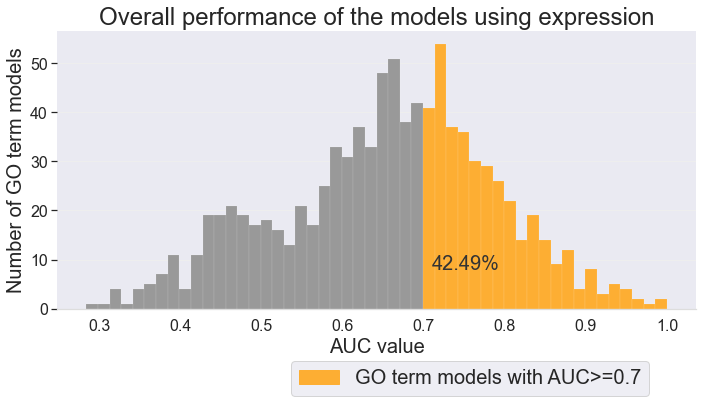

In [82]:
sns.set(rc={'figure.figsize':(10,6)})
fig, ax = plt.subplots()
perc = str(round((100*len(GO_terms_auc_svm_df[GO_terms_auc_svm_df["auc"]>0.69])/len(GO_terms_auc_svm_df)),2))+"%"
N, bins, patches = plt.hist(GO_terms_auc_svm_df, color=CB_color_cycle[6],bins=50, linewidth=0.1)

for i in range(0,len(bins)-1):
    if bins[i]>0.69:
        patches[i].set_facecolor(CB_color_cycle[2])

plt.yticks(fontsize=16)
plt.xticks(fontsize=16)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=True)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

plt.xlabel("AUC value", fontsize=20)
plt.ylabel("Number of GO term models", fontsize=20)
colors2 = {'GO term models with AUC>=0.7':CB_color_cycle[2]}  
labels = list(colors2.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors2[label]) for label in labels]
plt.legend(handles, labels,fontsize=20, loc="lower left", bbox_to_anchor=(0.35,-0.35))
plt.text(0.71, 8, str(perc), fontsize=20,color='#333333')
plt.title("Overall performance of the models using expression", fontsize=24)
# con el que mejor funciona es con la suma normal del attribution 
fig.tight_layout()
fig.savefig(resultsdir+'modelsAUCsvm.png', transparent=True)

## AUC waterfall plot

In [83]:
GO_terms_auc_svm_df =GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False)

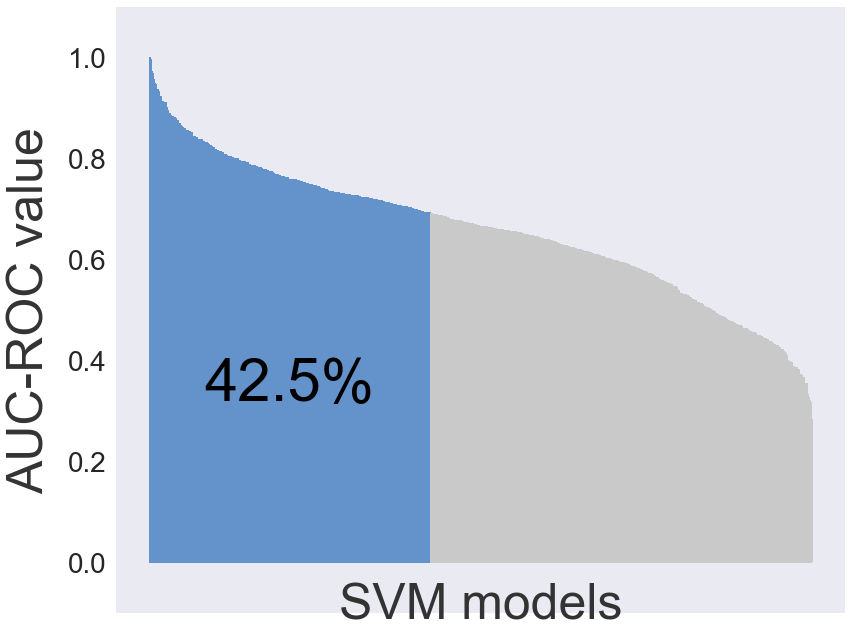

In [84]:
plt.rcParams['figure.figsize'] = (12, 9)
drugs = GO_terms_auc_svm_df.index
rhos = GO_terms_auc_svm_df["auc"]

percentage = round((sum(rhos>0.69)/len(rhos))*100,1)

fig, ax = plt.subplots()
#colors = ['#208EA3' if (x < 0.5) else '#A4C61A' for x in rhos ]
colors = ['#C9C9C9' if (x < 0.69) else "#6492CA" for x in rhos ]
ax.bar(
    x=drugs,
    height=rhos,
    edgecolor=colors,
    linewidth=2
)
plt.xticks([])
plt.yticks(fontsize=28)


# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
#ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=False)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(False)
ax.yaxis.grid(False)
#ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)


# Add labels and a title. Note the use of `labelpad` and `pad` to add some
# extra space between the text and the tick labels.
ax.set_xlabel('SVM models', labelpad=-30, color='#333333',fontsize=50)
ax.set_ylabel('AUC-ROC value', labelpad=15, color='#333333',fontsize=50)
ax.set_title('', color='#333333',
             weight='bold')

colors2 = {'High confidence drugs (r>0.5)':'#A4C61A'}  
labels = list(colors2.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors2[label]) for label in labels]
#plt.legend(handles, labels,fontsize=40, loc="lower left",bbox_to_anchor=(0, -0.215))
plt.text(77, 0.32, str(percentage)+"%", fontsize=60,color='#000000')

plt.ylim((-0.1,1.1))
# Make the chart fill out the figure better.
fig.tight_layout()
fig.savefig(resultsdir+'WaterfallModelsSVM.png', transparent=True)

## AUC boxplot by parents

In [225]:
# Add number of parents
number_parents = {}
levels = {}
for i in range(0,len(GO_terms_auc_svm_df.index)):
    term = GO_terms_auc_svm_df.index[i]
    number_parents[GO_terms_auc_svm_df.index[i]]=len([source for source, _ in  dG.in_edges(term)])
    levels[GO_terms_auc_svm_df.index[i]]=level_number[term]-1
levels = pd.DataFrame.from_dict(levels, orient='index')
number_parents = pd.DataFrame.from_dict(number_parents, orient='index')

GO_terms_auc_svm_df = pd.concat([GO_terms_auc_svm_df, levels,number_parents], axis=1)
GO_terms_auc_svm_df.columns = ["auc","levels","parents"]

In [226]:
GO_terms_auc_svm_df.head()

,auc,levels,parents
GO:0000077,0.284021,1,3
GO:0045737,0.835954,0,8
GO:0000082,0.732331,2,4
GO:1900087,0.593301,0,10
GO:2000134,0.865329,1,9


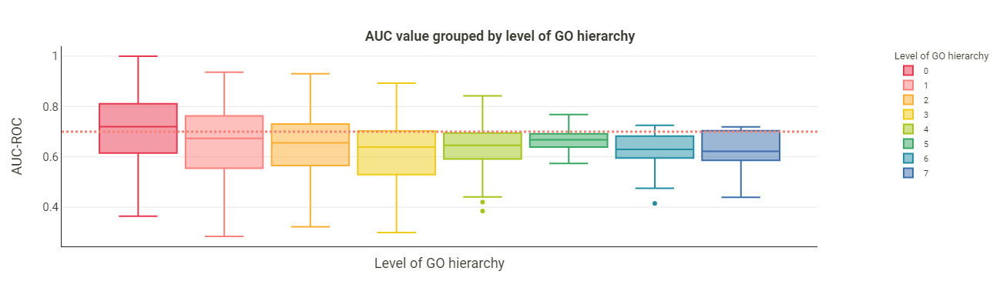

In [87]:
import plotly.express as px

c = ['#E8384F', '#FD817D', '#FDAE33',
         '#EECC16', '#A4C61A', '#37A862',"#208EA3","#3B6EAB"]

df = px.data.tips()
fig = px.box(GO_terms_auc_svm_df, x="levels", y="auc",
             color="levels",
            color_discrete_sequence=c,
             width =600,
             height=400,
              template="simple_white",
              labels=dict(levels="Level of GO hierarchy", auc="AUC-ROC")
            )
fig.update_traces(width=0.9)

fig.add_shape( # add a horizontal "target" line
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=0.7, y1=0.7, yref="y"
)


fig.update_layout(
   title=dict(text="<b> AUC value grouped by level of GO hierarchy <b>",
             x=0.5,
             y=0.9,
              font=dict(size=18),
              xanchor='center',
              yanchor='top'),
    xaxis=dict(ticks="", showticklabels=False, showgrid=False, zeroline=False),
    yaxis=dict(ticks="", showticklabels=True, showgrid=True, zeroline=False),
 #   yaxis_range=[min(yy.flatten()),max(yy.flatten())],
  #  xaxis_range=[min(xx.flatten()),max(xx.flatten())],
    legend=dict(x=1.1, y=1, orientation="v",font=dict(size=11)),
    paper_bgcolor='rgba(0,0,0,0)',
    font=dict(family='Roboto',color= "#36382E",size=15)
    )

fig.show()

## TOP 15 PREDICTED GO TERMS

In [88]:
top15goterms= np.array(GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False)[0:15].index)

Get Top GO term names

In [ ]:
top15goterms_1 = []
for goterm in top15goterms:
    top15goterms_1.append(goterm+"_"+str(1))
real_go_info_mod_best = real_go_info[real_go_info.GO_term.isin(top15goterms_1)]
real_go_info_mod_best.GO_term = real_go_info_mod_best.GO_term.str.replace("_1","")

In [90]:
top15goterms_auc = GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False)[0:15].reset_index()
top15goterms_auc.columns=["GO_term","auc","levels","parents"]

In [91]:
top15goterms_auc = top15goterms_auc.merge(real_go_info_mod_best[real_go_info_mod_best["GO_term"].isin(top15goterms)], on="GO_term")

In [92]:
top15goterms_auc

,GO_term,auc,levels,parents,Name,layer_number
0,GO:0036289,0.999708,0,2,Peptidyl-serine autophosphorylation (1),0.0
1,GO:0060440,0.994743,0,4,Trachea formation (1),0.0
2,GO:0042149,0.971292,0,1,Cellular response to glucose starvation (1),0.0
3,GO:1902455,0.969545,0,2,Negative regulation of stem cell population maintenance (1),0.0
4,GO:0001556,0.965979,0,6,Oocyte maturation (1),0.0
5,GO:0045636,0.955115,0,6,Positive regulation of melanocyte differentiation (1),0.0
6,GO:0010750,0.955000,0,4,Positive regulation of nitric oxide mediated signal transduction (1),0.0
7,GO:0060020,0.949434,0,1,Bergmann glial cell differentiation (1),0.0
8,GO:1902042,0.945804,0,4,Negative regulation of extrinsic apoptotic signaling pathway via death domain receptors (1),0.0
9,GO:1902236,0.941667,0,12,Negative regulation of endoplasmic reticulum stress-induced intrinsic apoptotic signaling pathway (1),0.0


## WORST 15 PREDICTED GO TERMS

In [93]:
worst15goterms= np.array(GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=True)[0:15].index)

Get Worst GO term names

In [ ]:
worst15goterms_1 = []
for goterm in worst15goterms:
    worst15goterms_1.append(goterm+"_"+str(1))
real_go_info_mod_worst = real_go_info[real_go_info.GO_term.isin(worst15goterms_1)]
real_go_info_mod_worst.GO_term = real_go_info_mod_worst.GO_term.str.replace("_1","")

In [95]:
worst15goterms_auc = GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=True)[0:15].reset_index()
worst15goterms_auc.columns=["GO_term","auc","levels","parents"]

In [96]:
worst15goterms_auc.merge(real_go_info_mod_worst[real_go_info_mod_worst["GO_term"].isin(worst15goterms)], on="GO_term")

,GO_term,auc,levels,parents,Name,layer_number
0,GO:0000077,0.284021,1,3,Dna damage checkpoint signaling (1),1.0
1,GO:0006869,0.299648,3,2,Lipid transport (1),3.0
2,GO:0051302,0.314545,1,2,Regulation of cell division (1),1.0
3,GO:0016485,0.318636,3,5,Protein processing (1),3.0
4,GO:0019722,0.322272,2,1,Calcium-mediated signaling (1),2.0
5,GO:0046854,0.326276,1,2,Phosphatidylinositol phosphate biosynthetic process (1),1.0
6,GO:0060740,0.331825,1,6,Prostate gland epithelium morphogenesis (1),1.0
7,GO:0060444,0.347273,1,8,Branching involved in mammary gland duct morphogenesis (1),1.0
8,GO:0006919,0.352725,1,3,Activation of cysteine-type endopeptidase activity involved in apoptotic process (1),1.0
9,GO:0032436,0.353421,1,14,Positive regulation of proteasomal ubiquitin-dependent protein catabolic process (1),1.0


## AUPR histogram

In [97]:
GO_terms_aupr_svm_df = pd.DataFrame(list(GO_terms_aupr_svm.items()),columns = ['goterm','aupr']).set_index("goterm")
GO_terms_aupr_svm_df = GO_terms_aupr_svm_df.dropna()
GO_terms_aupr_svm_df.sort_values(by=["aupr"], ascending=False).head()

,aupr
goterm,
GO:0036289,0.996209
GO:0006807,0.945077
GO:0050896,0.921869
GO:0043170,0.909722
GO:0009058,0.900903


In [98]:
# Add number of parents
number_parents = {}
levels = {}
for i in range(0,len(GO_terms_aupr_svm_df.index)):
    term = GO_terms_aupr_svm_df.index[i]
    number_parents[GO_terms_aupr_svm_df.index[i]]=len([source for source, _ in  dG.in_edges(term)])
    levels[GO_terms_aupr_svm_df.index[i]]=level_number[term]-1
levels = pd.DataFrame.from_dict(levels, orient='index')
number_parents = pd.DataFrame.from_dict(number_parents, orient='index')

GO_terms_aupr_svm_df = pd.concat([GO_terms_aupr_svm_df, levels,number_parents], axis=1)
GO_terms_aupr_svm_df.columns = ["aupr","levels","parents"]

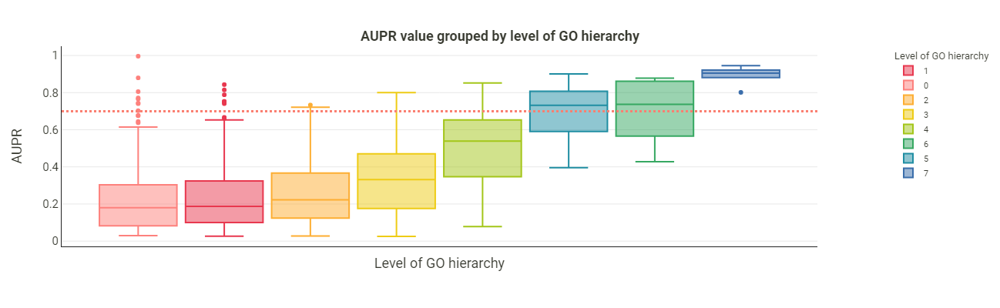

In [99]:
c = ['#E8384F', '#FD817D', '#FDAE33',
         '#EECC16', '#A4C61A', '#37A862',"#208EA3","#3B6EAB"]

df = px.data.tips()
fig = px.box(GO_terms_aupr_svm_df, x="levels", y="aupr",
             color="levels",
            color_discrete_sequence=c,
             width =600,
             height=400,
              template="simple_white",
              labels=dict(levels="Level of GO hierarchy", aupr="AUPR")
            )
fig.update_traces(width=0.9)

fig.add_shape( # add a horizontal "target" line
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=0.7, y1=0.7, yref="y"
)


fig.update_layout(
   title=dict(text="<b> AUPR value grouped by level of GO hierarchy <b>",
             x=0.5,
             y=0.9,
              font=dict(size=18),
              xanchor='center',
              yanchor='top'),
    xaxis=dict(ticks="", showticklabels=False, showgrid=False, zeroline=False),
    yaxis=dict(ticks="", showticklabels=True, showgrid=True, zeroline=False),
 #   yaxis_range=[min(yy.flatten()),max(yy.flatten())],
  #  xaxis_range=[min(xx.flatten()),max(xx.flatten())],
    legend=dict(x=1.1, y=1, orientation="v",font=dict(size=11)),
    paper_bgcolor='rgba(0,0,0,0)',
    font=dict(family='Roboto',color= "#36382E",size=15)
    )

fig.show()
pio.write_image(fig, resultsdir+"AUPR_levels.png", width=600, height=400,scale=8)

## Example prediction

In [100]:
def f2(goterm):    
    return goterm

In [101]:
combobox_go = interactive(f2, goterm=widgets.Combobox(options=list(GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False).index)))

**Choose drug to study...**

In [105]:
display(combobox_go)

interactive(children=(Combobox(value='GO:0060440', description='goterm', options=('GO:0036289', 'GO:0060440', …

In [106]:
selected_go = combobox_go.result

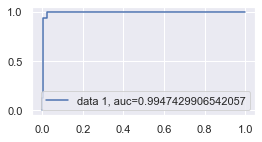

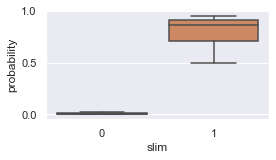

In [129]:
#auc
plt.rcParams['figure.figsize'] = (4, 2)
fpr, tpr, _ = metrics.roc_curve(slim_matrix_single_neuron.loc[selected_go],  platt_matrix.loc[selected_go])
auc = metrics.roc_auc_score(slim_matrix_single_neuron.loc[selected_go],  platt_matrix.loc[selected_go])
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

plot = pd.concat([pd.DataFrame(slim_matrix_single_neuron.loc[selected_go]),pd.DataFrame(platt_matrix.loc[selected_go])], axis=1)
plot.columns = ["slim","probability"]
ax = sns.boxplot(x="slim", y="probability", data=plot,showfliers=False )

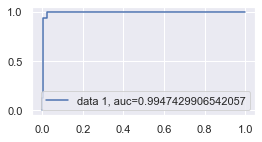

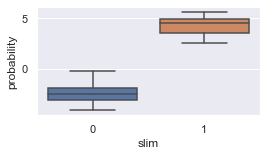

In [130]:
#auc 
fpr, tpr, _ = metrics.roc_curve(slim_matrix_single_neuron.loc[selected_go],  delta_logits_matrix.loc[selected_go])
auc = metrics.roc_auc_score(slim_matrix_single_neuron.loc[selected_go],  delta_logits_matrix.loc[selected_go])
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

plot = pd.concat([pd.DataFrame(slim_matrix_single_neuron.loc[selected_go]),pd.DataFrame(delta_logits_matrix.loc[selected_go])], axis=1)
plot.columns = ["slim","probability"]
ax = sns.boxplot(x="slim", y="probability", data=plot,showfliers=False )

Accuracy: 0.9782608695652174
Precision: 0.7894736842105263
Recall: 0.9375
AUC with score: 0.9947429906542057


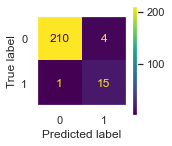

In [131]:
plt.rcParams['figure.figsize'] = (2, 2)
metrics.ConfusionMatrixDisplay.from_predictions(slim_matrix_single_neuron.loc[selected_go], preds_svm_matrix.loc[selected_go])
plt.grid(visible=None)

print("Accuracy:",metrics.accuracy_score(slim_matrix_single_neuron.loc[selected_go], preds_svm_matrix.loc[selected_go]))
print("Precision:",metrics.precision_score(slim_matrix_single_neuron.loc[selected_go], preds_svm_matrix.loc[selected_go]))
print("Recall:",metrics.recall_score(slim_matrix_single_neuron.loc[selected_go], preds_svm_matrix.loc[selected_go])) #TP / (TP+FN)
print("AUC with score:",auc) #TP / (TP+FN)

TN  -  FP

FN  -  TP

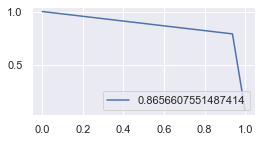

In [133]:
plt.rcParams['figure.figsize'] = (4, 2)
precision, recall, thresholds = metrics.precision_recall_curve(slim_matrix_single_neuron.loc[selected_go],  preds_svm_matrix.loc[selected_go])
auc_precision_recall = metrics.auc(recall, precision)
plt.plot(recall, precision,label=str(auc_precision_recall))
plt.legend(loc=4)
plt.show()

## METRICS drugs

In [116]:
auc_drugs = {}
aupr_drugs = {}
precision_drugs = {}
for drug in list(slim_matrix_single_neuron.columns):
    if slim_matrix_single_neuron.loc[:,drug].sum() ==0:
        continue
    #fpr, tpr, _ = metrics.roc_curve(slim_matrix_single_neuron.loc[:,drug], logits_matrix.loc[:,drug])
    #auc_drugs[drug]  = metrics.auc(fpr, tpr)
    auc_drugs[drug] = metrics.roc_auc_score(slim_matrix_single_neuron.loc[:,drug],  platt_matrix.loc[:,drug])
    precision, recall, thresholds = metrics.precision_recall_curve(slim_matrix_single_neuron.loc[:,drug],  platt_matrix.loc[:,drug])
    aupr_drugs[drug] = metrics.auc(recall, precision)
    precision_drugs[drug] = metrics.precision_score(slim_matrix_single_neuron.loc[:,drug],  preds_svm_matrix.loc[:,drug])

auc_drugs_df = pd.DataFrame(list(auc_drugs.items()),columns = ['goterm','auc']).set_index("goterm")
auc_drugs_df = auc_drugs_df.dropna()

aupr_drugs_df = pd.DataFrame(list(aupr_drugs.items()),columns = ['goterm','aupr']).set_index("goterm")
aupr_drugs_df = aupr_drugs_df.dropna()

precision_drugs_df = pd.DataFrame(list(precision_drugs.items()),columns = ['goterm','precision']).set_index("goterm")
precision_drugs_df = precision_drugs_df.dropna()

### AUC histogram drugs

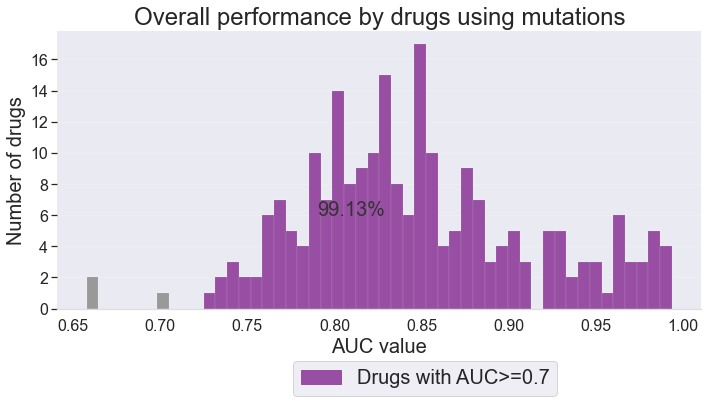

In [117]:
sns.set(rc={'figure.figsize':(10,6)})
fig, ax = plt.subplots()
perc = str(round((100*len(auc_drugs_df[auc_drugs_df["auc"]>0.7])/len(auc_drugs_df)),2))+"%"
N, bins, patches = plt.hist(auc_drugs_df, color=CB_color_cycle[6],bins=50, linewidth=0.1)

for i in range(0,len(bins)-1):
    if bins[i]>0.7:
        patches[i].set_facecolor(CB_color_cycle[5])

plt.yticks(fontsize=16)
plt.xticks(fontsize=16)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=True)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

plt.xlabel("AUC value", fontsize=20)
plt.ylabel("Number of drugs", fontsize=20)
colors2 = {'Drugs with AUC>=0.7':CB_color_cycle[5]}  
labels = list(colors2.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors2[label]) for label in labels]
plt.legend(handles, labels,fontsize=20, loc="lower left", bbox_to_anchor=(0.35,-0.35))
plt.text(0.79, 6, str(perc), fontsize=20,color='#333333')
plt.title("Overall performance by drugs using mutations", fontsize=24)
# con el que mejor funciona es con la suma normal del attribution 
fig.tight_layout()
fig.savefig(resultsdir+'drugsAUC.png', transparent=True)

### AUC waterfall plot drugs

In [118]:
auc_drugs_df =auc_drugs_df.sort_values(by=["auc"], ascending=False)

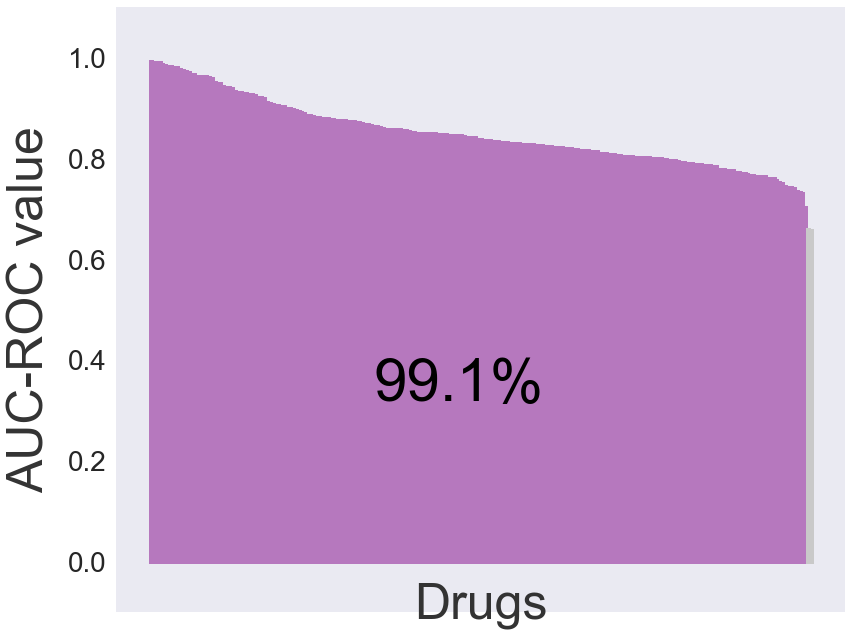

In [119]:
plt.rcParams['figure.figsize'] = (12, 9)
drugs = auc_drugs_df.index
rhos = auc_drugs_df["auc"]

percentage = round((sum(rhos>0.69)/len(rhos))*100,1)

fig, ax = plt.subplots()
#colors = ['#208EA3' if (x < 0.5) else '#A4C61A' for x in rhos ]
colors = ['#C9C9C9' if (x < 0.69) else "#B678BE" for x in rhos ]
ax.bar(
    x=drugs,
    height=rhos,
    edgecolor=colors,
    linewidth=3
)
plt.xticks([])
plt.yticks(fontsize=28)


# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
#ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=False)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(False)
ax.yaxis.grid(False)
#ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)


# Add labels and a title. Note the use of `labelpad` and `pad` to add some
# extra space between the text and the tick labels.
ax.set_xlabel('Drugs', labelpad=-30, color='#333333',fontsize=50)
ax.set_ylabel('AUC-ROC value', labelpad=15, color='#333333',fontsize=50)
ax.set_title('', color='#333333',
             weight='bold')

colors2 = {'High confidence drugs (r>0.5)':'#A4C61A'}  
labels = list(colors2.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors2[label]) for label in labels]
#plt.legend(handles, labels,fontsize=40, loc="lower left",bbox_to_anchor=(0, -0.215))
plt.text(77, 0.32, str(percentage)+"%", fontsize=60,color='#000000')

plt.ylim((-0.1,1.1))
# Make the chart fill out the figure better.
fig.tight_layout()
fig.savefig(resultsdir+'WaterfallModelsSVM_drugs.png', transparent=True)

### AUPR histogram drugs

Text(0.5, 1.0, '33.62%')

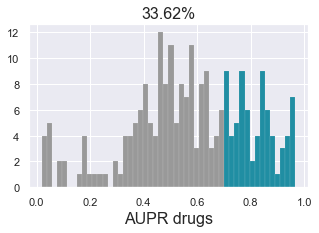

In [120]:
sns.set(rc={'figure.figsize':(5,3)})
perc = str(round((100*len(aupr_drugs_df[aupr_drugs_df["aupr"]>0.69])/len(aupr_drugs_df)),2))+"%"
N, bins, patches = plt.hist(aupr_drugs_df, color=CB_color_cycle[6],bins=50, linewidth=0.1)
for i in range(0,len(bins)-1):
    if bins[i]>0.69:
        patches[i].set_facecolor(CB_color_cycle[3])

plt.xlabel("AUPR drugs", fontsize=16)  
plt.title(perc, fontsize=16)

### Example drug prediction

In [121]:
def f(drug):    
    
    return drug

In [122]:
predictions_nodes = []
for goterm in list(platt_matrix.index):
    predictions_nodes.append(goterm+"_"+str(1))

In [ ]:
# add names to go terms
real_go_info_svm= real_go_info[real_go_info.GO_term.isin(predictions_nodes)]
real_go_info_svm.GO_term = real_go_info_svm.GO_term.str.replace("_1","")

In [124]:
combobox = interactive(f, drug=widgets.Combobox(options=list(precision_drugs_df.sort_values(by=["precision"], ascending=False).index)))

**Choose drug to study...**

In [126]:
display(combobox)

interactive(children=(Combobox(value='regorafenib', description='drug', options=('regorafenib', 'navitoclax + …

In [127]:
selected_drug_name = combobox.result

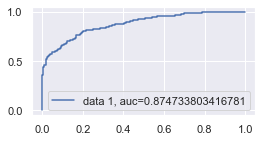

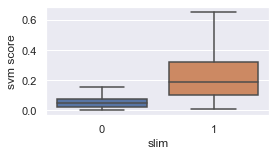

In [128]:
sns.set(rc={'figure.figsize':(4,2)})
#auc
fpr, tpr, _ = metrics.roc_curve(slim_matrix_single_neuron.loc[:,selected_drug_name], platt_matrix.loc[:,selected_drug_name] )
auc = metrics.roc_auc_score(slim_matrix_single_neuron.loc[:,selected_drug_name],  platt_matrix.loc[:,selected_drug_name])
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

plot = pd.concat([pd.DataFrame(slim_matrix_single_neuron.loc[:,selected_drug_name]),pd.DataFrame(platt_matrix.loc[:,selected_drug_name])], axis=1)
plot.columns = ["slim","svm score"]
ax = sns.boxplot(x="slim", y="svm score", data=plot,showfliers=False )

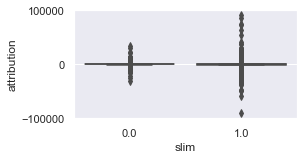

In [137]:
plot = pd.concat([pd.DataFrame(slim_matrix.loc[:,selected_drug_name]),pd.DataFrame(attribution_data_annotated.loc[:,selected_drug_name]*1e4)], axis=1)
plot.columns = ["slim","attribution"]
ax = sns.boxplot(x="slim", y="attribution", data=plot,showfliers=True )

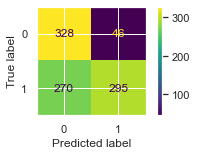

In [145]:
metrics.ConfusionMatrixDisplay.from_predictions(slim_matrix_single_neuron.loc[:,selected_drug_name].round(), preds_svm_matrix.loc[:,selected_drug_name])

In [150]:
print("Accuracy:",metrics.accuracy_score(slim_matrix_single_neuron.loc[:,selected_drug_name], preds_svm_matrix.loc[:,selected_drug_name]))
print("Precision:",metrics.precision_score(slim_matrix_single_neuron.loc[:,selected_drug_name], preds_svm_matrix.loc[:,selected_drug_name]))
print("Recall:",metrics.recall_score(slim_matrix_single_neuron.loc[:,selected_drug_name], preds_svm_matrix.loc[:,selected_drug_name])) #TP / (TP+FN)
print("AUC with score:",auc) 

Accuracy: 0.663471778487753
Precision: 0.8651026392961877
Recall: 0.5221238938053098
AUC with score: 0.9947429906542057


In [ ]:
# LOS LOGITS DE TEST!!
train_drug_logs = pd.DataFrame(delta_logits_matrix.loc[:,selected_drug_name]).reset_index()
train_drug_logs.columns  = ["GO_term","probability"]
train_drug_logs = train_drug_logs.merge(real_go_info_svm, on="GO_term")
train_drug_logs.sort_values(by=["probability"], ascending=False)

## Final model SVM

Once the models have been cross-validated we create the final models using all samples...

In [152]:
GO_terms_auc_svm_final = {}
GO_terms_aupr_svm_final = {}
GO_terms_precision_svm_final = {}
models_svm = {}

# Perform logistics
for goterm in sparseGO_terms:
    #print(goterm)
    goterm_drugs = slim_matrix.loc[[goterm+"_"+str(1)]].values.flatten()
    
    if sum(goterm_drugs) <= 8:
        continue

    list_nodes = []
    for i in range(1,7):
        list_nodes.append(goterm+"_"+str(i))

    score = attribution_data_annotated.loc[list_nodes].T
    score_mod = score.divide(score.std()).fillna(0)
    
    X_train = score_mod
    X_test = score_mod
    y_train = goterm_drugs
    y_test = goterm_drugs
    
    #gamma = 1/(X_train.shape[1]*X_train.to_numpy().var())
    gamma="scale"
    C=1
    
    
        
    svm_model = svm.SVC(C=C,gamma=gamma, kernel='rbf',
                           class_weight="balanced",
                            tol=0.001,
                            probability=True,
                           random_state=1234)
    # fit the model with data
    svm_model.fit(X_train,y_train)
    y_pred=svm_model.predict(X_test)

    #auc
    y_pred_proba = svm_model.predict_proba(X_test)[::,1]  # platt values
    #y_pred_proba = svm_model.decision_function(X_test)
    
    GO_terms_auc_svm_final[goterm] = metrics.roc_auc_score(y_test, y_pred_proba)

    precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_pred_proba)
    GO_terms_aupr_svm_final[goterm] = metrics.auc(recall, precision)
    GO_terms_precision_svm_final[goterm] = metrics.precision_score(y_test, y_pred)
    models_svm[goterm]=svm_model

In [153]:
len(models_svm)

939

### Final model AUC

In [154]:
GO_terms_auc_svm_df_final = pd.DataFrame(list(GO_terms_auc_svm_final.items()),columns = ['goterm','auc']).set_index("goterm")
GO_terms_auc_svm_df_final = GO_terms_auc_svm_df_final.dropna()
GO_terms_auc_svm_df_final.sort_values(by=["auc"], ascending=False)

,auc
goterm,
GO:0036289,1.000000
GO:0060440,0.998540
GO:0043162,0.995455
GO:0070059,0.994760
GO:0071364,0.994109
GO:1901029,0.994048
GO:0072384,0.993636
GO:0051453,0.993393
GO:0001556,0.991972


Text(0.5, 1.0, '94.68%')

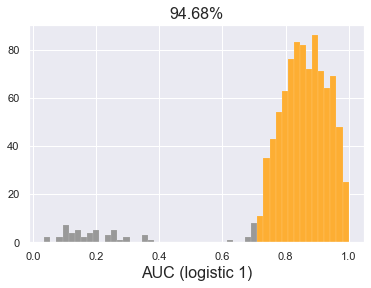

In [155]:
sns.set(rc={'figure.figsize':(6,4)})
perc = str(round((100*len(GO_terms_auc_svm_df_final[GO_terms_auc_svm_df_final["auc"]>0.7])/len(GO_terms_auc_svm_df_final)),2))+"%"
N, bins, patches = plt.hist(GO_terms_auc_svm_df_final, color=CB_color_cycle[6],bins=50, linewidth=0.1)

for i in range(0,len(bins)-1):
    if bins[i]>0.7:
        patches[i].set_facecolor(CB_color_cycle[2])

plt.xlabel("AUC (logistic 1)", fontsize=16)  
plt.title(perc, fontsize=16)
# con el que mejor funciona es con la suma normal del attribution 

### Final model AUPR

In [156]:
GO_terms_aupr_svm_df_final = pd.DataFrame(list(GO_terms_aupr_svm_final.items()),columns = ['goterm','aupr']).set_index("goterm")
GO_terms_aupr_svm_df_final = GO_terms_aupr_svm_df_final.dropna()
GO_terms_aupr_svm_df_final.sort_values(by=["aupr"], ascending=False).head()

,aupr
goterm,
GO:0036289,1.000000
GO:0050896,0.995438
GO:0043170,0.989680
GO:0006807,0.987396
GO:0060440,0.978213


Text(0.5, 1.0, '20.02%')

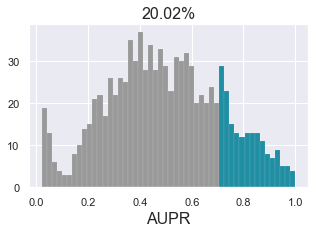

In [157]:
# TENGO PROBLEMA CON EL RECALL 
sns.set(rc={'figure.figsize':(5,3)})
perc = str(round((100*len(GO_terms_aupr_svm_df_final[GO_terms_aupr_svm_df_final["aupr"]>0.7])/len(GO_terms_aupr_svm_df_final)),2))+"%"
N, bins, patches = plt.hist(GO_terms_aupr_svm_df_final, color=CB_color_cycle[6],bins=50, linewidth=0.1)
for i in range(0,len(bins)-1):
    if bins[i]>0.7:
        patches[i].set_facecolor(CB_color_cycle[3])

plt.xlabel("AUPR", fontsize=16)  
plt.title(perc, fontsize=16)

## Predict for a new drug 

### Make predictions

In [158]:
unknown = list(set(attribution_data_all.columns)-set(attribution_data_annotated.columns))

Get the probabilities for all unknown drugs

In [ ]:
predictions = {}
distances = {}
probabilities_unknown = pd.DataFrame()
preds_unknown = pd.DataFrame()

for drug in unknown:
    probabilities = {}
    for goterm in models_svm.keys():

        list_nodes = list(models_svm[goterm].feature_names_in_) # Extract the feature names from the model (those are the attributions we need)

        score = attribution_data_all.loc[list_nodes][drug].to_frame().T 
        score_mod = score.divide(attribution_data_annotated.loc[list_nodes].T.std()).fillna(0) #divide by std of each neuron, only use drugs that trained the models

        predictions[goterm]=models_svm[goterm].predict(score_mod)
        probabilities[goterm] = models_svm[goterm].predict_proba(score_mod)[::,1]  # platt values
        # distances[goterm] = models_svm[goterm].decision_function(score_mod)
        
    drug_probs = pd.DataFrame.from_dict(probabilities).T
    drug_probs.columns = [drug]
    drug_preds = pd.DataFrame.from_dict(predictions).T
    drug_preds.columns = [drug]    
    probabilities_unknown = pd.concat([probabilities_unknown,drug_probs], axis=1)
    preds_unknown = pd.concat([preds_unknown,drug_preds], axis=1)
    print(drug)

### Study drug with unknown MOA

**Choose drug with unknown MOA...**

In [160]:
combobox_u = interactive(f, drug=widgets.Combobox(options=unknown))

In [161]:
predictions_nodes = []
for goterm in list(platt_matrix.index):
    predictions_nodes.append(goterm+"_"+str(1))

In [162]:
# add names to go terms
real_go_info_svm= real_go_info[real_go_info.GO_term.isin(predictions_nodes)]
real_go_info_svm.GO_term = real_go_info_svm.GO_term.str.replace("_1","")

In [164]:
display(combobox_u)

interactive(children=(Combobox(value='elesclomol', description='drug', options=('brd-k19103580-001-01-2', 'nvp…

In [165]:
selected_drug_u_name = combobox_u.result

In [166]:
predictions_df = pd.DataFrame.from_dict(preds_unknown.loc[:,selected_drug_u_name]).reset_index()
predictions_df.columns  = ["GO_term","predictions"]

In [167]:
probabilities_df = pd.DataFrame.from_dict(probabilities_unknown.loc[:,selected_drug_u_name]).reset_index()
probabilities_df.columns  = ["GO_term","probability"]
probabilities_df = probabilities_df.merge(real_go_info_svm, on="GO_term")
probabilities_df = probabilities_df.merge(predictions_df, on="GO_term")
probabilities_df.loc[probabilities_df["layer_number"] <=3].sort_values(by=["probability"], ascending=False).head(200)

,GO_term,probability,Name,layer_number,predictions
820,GO:0033993,0.809556,Response to lipid (1),3.0,1.0
223,GO:0018108,0.783375,Peptidyl-tyrosine phosphorylation (1),3.0,1.0
573,GO:0010629,0.742615,Negative regulation of gene expression (1),3.0,1.0
106,GO:0071900,0.725062,Regulation of protein serine/threonine kinase activity (1),2.0,1.0
624,GO:0010628,0.702924,Positive regulation of gene expression (1),3.0,1.0
74,GO:0001817,0.687600,Regulation of cytokine production (1),3.0,1.0
44,GO:0048812,0.672129,Neuron projection morphogenesis (1),3.0,1.0
224,GO:0046777,0.661031,Protein autophosphorylation (1),1.0,1.0
99,GO:0001934,0.658374,Positive regulation of protein phosphorylation (1),3.0,1.0
570,GO:0045597,0.628072,Positive regulation of cell differentiation (1),3.0,1.0


In [168]:
sum(probabilities_df["predictions"] ==1)

288

In [169]:
sum(probabilities_df["predictions"] ==0)

651

Probability < 0.5 doesn't mean it does not belong to the class, a probability of for example 0.2 can represent a 1 (annotated to MoA)

## Modify probabilities 

**Take into account the annotations each GO term has** (general GO terms are easier to predict as they have more annotations)

### For drug with unknown MOA...

In [170]:
sum_annotations = slim_matrix_single_neuron.T.sum()/slim_matrix_single_neuron.shape[1]
logits_apriori = np.log(sum_annotations/(1-sum_annotations))

logits_apost= np.log(probabilities_df["probability"]/(1-probabilities_df["probability"]))
delta_logits =logits_apost.to_numpy()- logits_apriori.to_numpy()
delta_logits_df = pd.DataFrame(delta_logits)
delta_logits_df.columns = ["delta_logits"]
probabilities_mod = probabilities_df.merge(delta_logits_df, left_index=True,right_index=True)

In [171]:
probabilities_mod.loc[probabilities_mod["predictions"] ==1].loc[probabilities_mod["layer_number"] <= 7].sort_values(by=["delta_logits"], ascending=False)

,GO_term,probability,Name,layer_number,predictions,delta_logits
839,GO:0031047,0.553888,Gene silencing by rna (1),2.0,1.0,2.192458
662,GO:0031648,0.377411,Protein destabilization (1),0.0,1.0,2.092834
106,GO:0071900,0.725062,Regulation of protein serine/threonine kinase activity (1),2.0,1.0,1.944569
33,GO:0000423,0.229518,Mitophagy (1),1.0,1.0,1.880007
538,GO:0048266,0.308838,Behavioral response to pain (1),0.0,1.0,1.857031
913,GO:0090630,0.231968,Activation of gtpase activity (1),0.0,1.0,1.793943
216,GO:0045727,0.270882,Positive regulation of translation (1),1.0,1.0,1.746070
223,GO:0018108,0.783375,Peptidyl-tyrosine phosphorylation (1),3.0,1.0,1.672826
719,GO:0043244,0.305739,Regulation of protein-containing complex disassembly (1),2.0,1.0,1.646098
241,GO:0006612,0.288796,Protein targeting to membrane (1),1.0,1.0,1.626841


In [172]:
names2 = list(probabilities_mod.loc[probabilities_mod["predictions"] ==1].loc[probabilities_mod["layer_number"] <=7].sort_values(by=["delta_logits"], ascending=False)["Name"].head(30))
terms2 = list(probabilities_mod.loc[probabilities_mod["predictions"] ==1].loc[probabilities_mod["layer_number"] <=7].sort_values(by=["delta_logits"], ascending=False)["GO_term"].head(30))
logits2 = list(probabilities_mod.loc[probabilities_mod["predictions"] ==1].loc[probabilities_mod["layer_number"] <=7].sort_values(by=["delta_logits"], ascending=False)["delta_logits"].head(30))

names2 = [x[:-4] for x in names2] 

In [173]:
for i in range(0,len(names2)):
    print(terms2[i],names2[i],logits2[i])

GO:0031047 Gene silencing by rna 2.192457619336144
GO:0031648 Protein destabilization 2.092833916210919
GO:0071900 Regulation of protein serine/threonine kinase activity 1.944569179670069
GO:0000423 Mitophagy 1.8800065969407627
GO:0048266 Behavioral response to pain 1.8570307139212263
GO:0090630 Activation of gtpase activity 1.793943480641404
GO:0045727 Positive regulation of translation 1.7460704310285706
GO:0018108 Peptidyl-tyrosine phosphorylation 1.6728257190053135
GO:0043244 Regulation of protein-containing complex disassembly 1.6460980615310405
GO:0006612 Protein targeting to membrane 1.6268405228374492
GO:0006469 Negative regulation of protein kinase activity 1.5937943848967007
GO:0034976 Response to endoplasmic reticulum stress 1.575980420814227
GO:0071353 Cellular response to interleukin-4 1.5752555355925209
GO:0033554 Cellular response to stress 1.573975479674923
GO:0033993 Response to lipid 1.5515734212063519
GO:0001817 Regulation of cytokine production 1.5347154822720621
GO

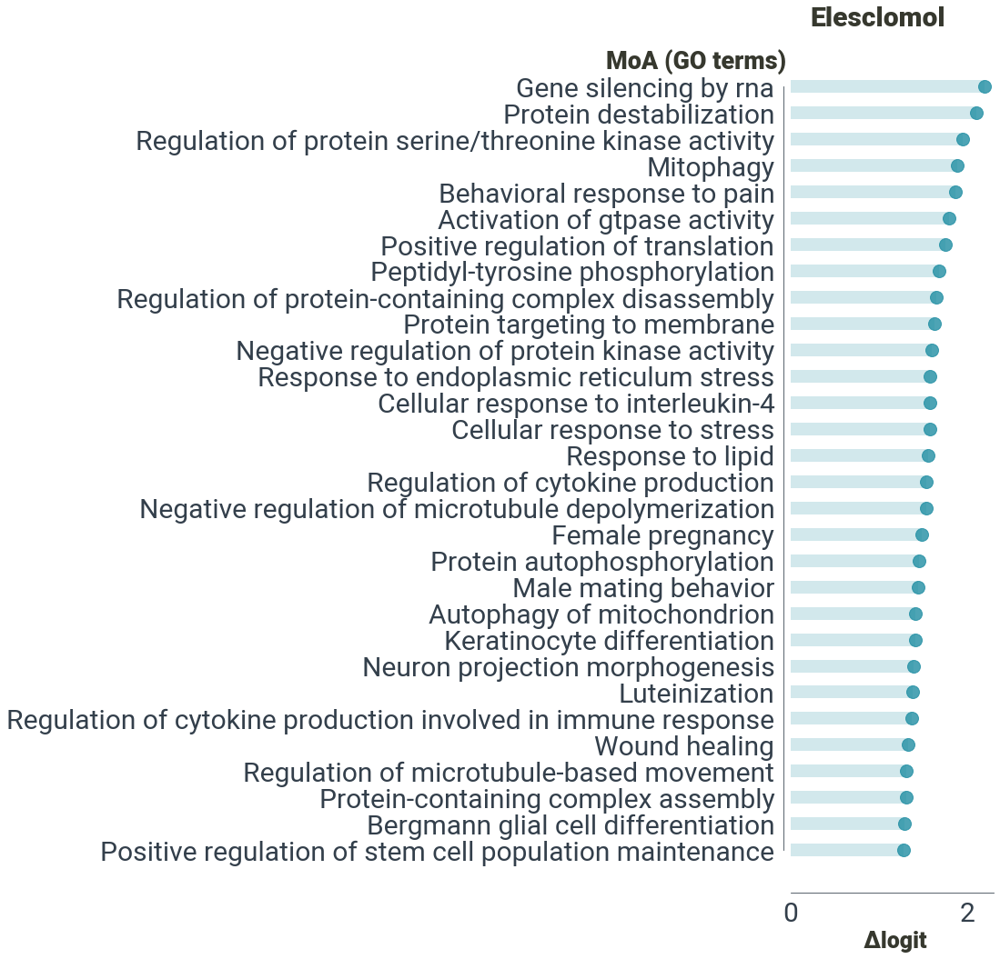

In [174]:
# import libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# set font
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = 'Roboto'

# set the style of the axes and the text color
plt.rcParams['axes.edgecolor']='#333F4B'
plt.rcParams['axes.linewidth']=0.8
plt.rcParams['xtick.color']='#333F4B'
plt.rcParams['ytick.color']='#333F4B'
plt.rcParams['text.color']='#333F4B'


# create some fake data
percentages = pd.Series(logits2, 
                        index=names2)
df = pd.DataFrame({'percentage' : percentages})
df = df.sort_values(by='percentage')

# we first need a numeric placeholder for the y axis
my_range=list(range(1,len(df.index)+1))

fig, ax = plt.subplots(figsize=(4,17))

# create for each expense type an horizontal line that starts at x = 0 with the length 
# represented by the specific expense percentage value.
plt.hlines(y=my_range, xmin=0, xmax=df['percentage'], color='#208EA3', alpha=0.2, linewidth=14)

# create for each expense type a dot at the level of the expense percentage value
plt.plot(df['percentage'], my_range, "o", markersize=14, color='#208EA3', alpha=0.8)

# set labels
ax.set_xlabel(' Δlogit', fontsize=25, fontweight='black', color = '#36382E')
ax.set_ylabel('')
ax.set_facecolor(color="white")
ax.set_alpha(1)

# set axis
ax.tick_params(axis='both', which='major', labelsize=30)
plt.yticks(my_range, df.index)

# add an horizonal label for the y axis 
fig.text(-0.58, 0.862, 'MoA (GO terms)', fontsize=27, fontweight='black', color = '#36382E')
fig.text(0.2, 0.9, selected_drug_u_name.capitalize(), fontsize=30, fontweight='black', color = '#36382E')


# change the style of the axis spines
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.spines['left'].set_bounds((1, len(my_range)))
ax.set_xlim(0,max(logits2)+0.1)

ax.spines['left'].set_position(('outward', 8))
ax.spines['bottom'].set_position(('outward', 5))

plt.savefig(resultsdir+selected_drug_u_name+'_top_terms.png', dpi=300, bbox_inches='tight')

### For known drug... 

In [175]:
display(combobox)

interactive(children=(Combobox(value='regorafenib', description='drug', options=('regorafenib', 'navitoclax + …

In [176]:
selected_drug_name = combobox.result

In [177]:
# LOS LOGITS DE TEST!!
train_drug_logs = pd.DataFrame(platt_matrix.loc[:,selected_drug_name]).reset_index()
train_drug_logs.columns  = ["GO_term","probability"]
train_drug_logs = train_drug_logs.merge(real_go_info_svm, on="GO_term")

In [ ]:
train_drug_logs.loc[train_drug_logs["layer_number"] <=3].sort_values(by=["probability"], ascending=False).head(30)

In [179]:
# # For known drugs
len((set(train_drug_logs.loc[train_drug_logs["layer_number"] <=3].sort_values(by=["probability"], ascending=False).head(30)["GO_term"])).intersection(set(pd.DataFrame(compounds_GOterms_matches[selected_drug_name])[1])))

30

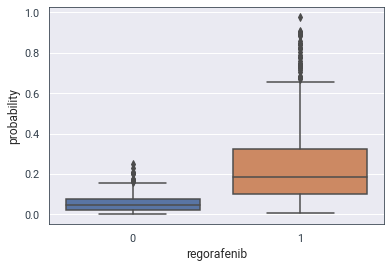

In [182]:
ax = sns.boxplot(x=slim_matrix_single_neuron.loc[train_drug_logs["GO_term"],selected_drug_name], y=train_drug_logs.set_index("GO_term")["probability"], data=plot,showfliers=True )

In [183]:
# same as before
sum_annotations = slim_matrix_single_neuron.T.sum()/slim_matrix_single_neuron.shape[1]
logits_apriori= np.log(sum_annotations/(1-sum_annotations))

In [184]:
logits_apost= np.log(train_drug_logs["probability"]/(1-train_drug_logs["probability"]))
delta_logits = logits_apost.to_numpy()-logits_apriori.to_numpy()
delta_logits_df = pd.DataFrame(delta_logits)
delta_logits_df.columns = ["delta_logits"]
train_drug_mod = train_drug_logs.merge(delta_logits_df, left_index=True,right_index=True)

In [185]:
train_drug_mod.loc[train_drug_mod["layer_number"] <=3].sort_values(by=["delta_logits"], ascending=False).head(30)

,GO_term,probability,Name,layer_number,delta_logits
578,GO:2000379,0.603184,Positive regulation of reactive oxygen species metabolic process (1),1.0,2.770126
253,GO:0043552,0.735601,Positive regulation of phosphatidylinositol 3-kinase activity (1),0.0,2.707570
80,GO:0010575,0.438910,Positive regulation of vascular endothelial growth factor production (1),0.0,2.282492
633,GO:0051301,0.817491,Cell division (1),2.0,2.245231
224,GO:0046777,0.780375,Protein autophosphorylation (1),1.0,2.053782
423,GO:1902533,0.825532,Positive regulation of intracellular signal transduction (1),2.0,2.014408
458,GO:0035025,0.374269,Positive regulation of rho protein signal transduction (1),0.0,1.952270
848,GO:0071670,0.345148,Smooth muscle cell chemotaxis (1),0.0,1.887644
348,GO:0006939,0.412178,Smooth muscle contraction (1),2.0,1.842256
350,GO:0045987,0.348868,Positive regulation of smooth muscle contraction (1),1.0,1.783402


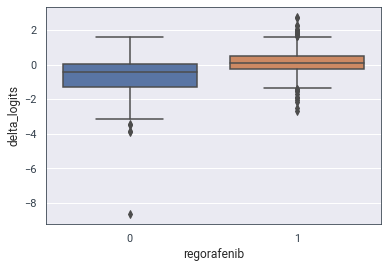

In [189]:
ax = sns.boxplot(x=slim_matrix_single_neuron.loc[train_drug_mod["GO_term"],selected_drug_name], y=train_drug_mod.set_index("GO_term")["delta_logits"], data=plot,showfliers=True)

## SVM GO TERM 2D representation

In [190]:
from sklearn.manifold import TSNE
import plotly.express as px

**Choose go to study...**

In [201]:
display(combobox_go)

interactive(children=(Combobox(value='GO:0071353', description='goterm', options=('GO:0036289', 'GO:0060440', …

In [202]:
selected_goterm = combobox_go.result

In [203]:
real_go_info[real_go_info["GO_term"]==selected_goterm+"_1"]

,GO_term,Name,layer_number
4338,GO:0071353_1,Cellular response to interleukin-4 (1),1.0


In [209]:
list_nodes = []
for i in range(1,7):
    list_nodes.append(selected_goterm+"_"+str(i))

score = attribution_data_annotated.loc[list_nodes].T
score_mod = score.divide(score.std()).fillna(0) 
annotations  =slim_matrix_single_neuron.loc[selected_goterm,]
y_predicted = models_svm[selected_goterm].predict(score_mod.astype(float))

### Plot SVM

#### View statistics of GOterm

*"Perfect" model (with train data)*

In [211]:
auc = metrics.roc_auc_score(annotations, models_svm[selected_goterm].decision_function(score_mod.astype(float)))
cnf_matrix = metrics.confusion_matrix(annotations,y_predicted)
print(cnf_matrix)

print("Accuracy:",metrics.accuracy_score(annotations, y_predicted))
print("Precision:",metrics.precision_score(annotations,y_predicted)) # TP / (TP+FP)
print("Recall:",metrics.recall_score(annotations, y_predicted)) #TP / (TP+FN)
print("AUC with score:",auc) 

[[206   6]
 [  2  16]]
Accuracy: 0.9652173913043478
Precision: 0.7272727272727273
Recall: 0.8888888888888888
AUC with score: 0.9855870020964361


TN  -  FP

FN  -  TP

En mi opinion interesa mucho el precision, prefiero que haya menos FP no??

*Test statistics...*

In [212]:
auc = metrics.roc_auc_score(slim_matrix_single_neuron.loc[selected_goterm],  platt_matrix.loc[selected_goterm])
cnf_matrix = metrics.confusion_matrix(slim_matrix_single_neuron.loc[selected_goterm], preds_svm_matrix.loc[selected_goterm])
print(cnf_matrix)

print("Accuracy:",metrics.accuracy_score(slim_matrix_single_neuron.loc[selected_goterm], preds_svm_matrix.loc[selected_goterm]))
print("Precision:",metrics.precision_score(slim_matrix_single_neuron.loc[selected_goterm], preds_svm_matrix.loc[selected_goterm]))
print("Recall:",metrics.recall_score(slim_matrix_single_neuron.loc[selected_goterm], preds_svm_matrix.loc[selected_goterm])) #TP / (TP+FN)
print("AUC with score:",auc) #TP / (TP+FN)

[[203   9]
 [  4  14]]
Accuracy: 0.9434782608695652
Precision: 0.6086956521739131
Recall: 0.7777777777777778
AUC with score: 0.9095911949685536


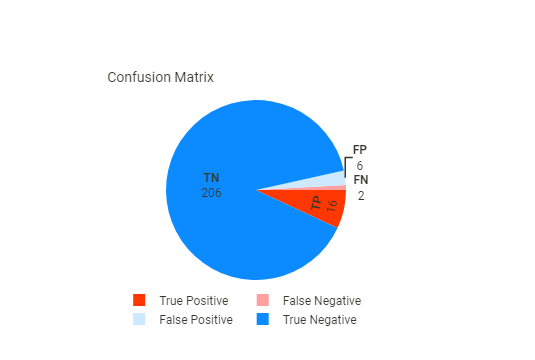

In [213]:
import colorlover as cl
matrix = metrics.confusion_matrix(annotations,y_predicted)
tn, fp, fn, tp = matrix.ravel()

values = [tp, fn, fp, tn]
label_text = ["True Positive", "False Negative", "False Positive", "True Negative"]
labels = ["<b>TP</b>", "<b>FN</b>", "<b>FP</b>", "<b>TN</b>"]
blue = cl.flipper()["seq"]["9"]["Blues"]
red = cl.flipper()["seq"]["9"]["Reds"]
colors = ["#ff3700","#FFA0A0", "#CCE9FF",  "#0b8bff"]
trace0 = go.Pie(
    labels=label_text,
    values=values,
    hoverinfo="label+value+percent",
    textinfo="text+value",
    text=labels,
    sort=False,
    marker=dict(colors=colors),
    insidetextfont={"color": "#36382E"},
    rotation=90,
)

layout = go.Layout(
    title=dict(text="Confusion Matrix",
              x=0.3,
              y=0.8,
              font=dict(size=14),
              xanchor='center',
              yanchor='top'),
    #margin=dict(l=50, r=50, t=100, b=10),
    legend=dict(font={"color": "#36382E"}, orientation="h",x=0.1, y=-0.03),
#    plot_bgcolor="#282b38",
#    paper_bgcolor="#282b38",
    font=dict(family='Roboto',color= "#36382E"),
)

data = [trace0]
figure = go.Figure(data=data, layout=layout)
figure

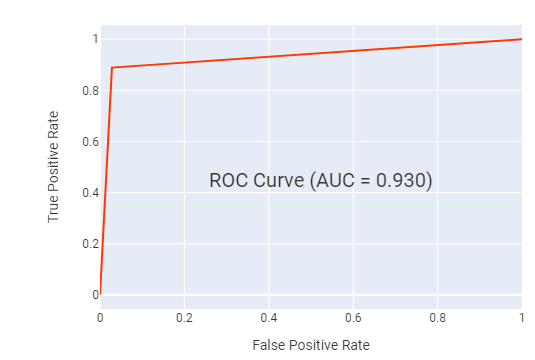

In [214]:
y_test=annotations
decision_test=y_predicted
fpr, tpr, threshold = metrics.roc_curve(y_test, decision_test)

# AUC Score
auc_score = metrics.roc_auc_score(y_true=y_test, y_score=decision_test)

trace0 = go.Scatter(
    x=fpr, y=tpr, mode="lines", name="Test Data", marker={"color": "#ff3700"}
)

layout = go.Layout(
    title=dict(text=f"ROC Curve (AUC = {auc_score:.3f})",
            x=0.6,
            y=0.5,
            font=dict(size=20)
              ),
    xaxis=dict(title="False Positive Rate", gridcolor="white"),
    yaxis=dict(title="True Positive Rate", gridcolor="white"),
    legend=dict(x=0, y=1.05, orientation="h"),
    margin=dict(l=100, r=10, t=25, b=40),
#    plot_bgcolor="#282b38",
#    paper_bgcolor="#282b38",
    font=dict(family='Roboto',color= "#36382E"),
)

data = [trace0]
figure = go.Figure(data=data, layout=layout)
figure

#### Plot SVM with unknown labels

#####  Voronoi Tessellation

What is a Voronoi Tessellation? Given a set P := {p1, ..., pn} of sites, a Voronoi Tessellation is a subdivision of the space into n cells, one for each site in P, with the property that a point q lies in the cell corresponding to a site pi iff d(pi, q) < d(pj, q) for i distinct from j. The segments in a Voronoi Tessellation correspond to all points in the plane equidistant to the two nearest sites. Voronoi Tessellations have applications in computer science.

https://stackoverflow.com/questions/61225052/svm-plot-decision-surface-when-working-with-more-than-2-features

In [ ]:
tsne = TSNE(n_components=2, verbose=0,
           init="pca",
            perplexity=30,
            random_state=123
           )
z = tsne.fit_transform(score_mod.astype(float)) 

In [216]:
list_nodes = list(models_svm[selected_goterm].feature_names_in_) # Extract the feature names from the model (those are the attributions we need)
score_unknown = attribution_data_all.loc[list_nodes,unknown].T
score_unknown_mod = score_unknown.divide(score.std()).fillna(0) # normalize

In [217]:
y_unknown = np.full(score_unknown_mod.shape[0],2) # 2=unknown MOA
y_pred_unknown = models_svm[selected_goterm].predict(score_unknown_mod.astype(float))

In [218]:
# join scores and annotations from known and unknown drugs
all_score = pd.concat([score_mod,score_unknown_mod])
all_y = np.concatenate((annotations,y_unknown))  # 2=unknown MOA

Plot T-SNE SVM

In [ ]:
from sklearn.neighbors._classification import KNeighborsClassifier
# https://github.com/plotly/dash-sample-apps/blob/main/apps/dash-svm/utils/dash_reusable_components.py
z = tsne.fit_transform(all_score.astype(float)) 
df = pd.DataFrame()
df["y"] = all_y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
df["name"] =list(all_score.index)
df = df.sort_values(by=['y'])
df["y"] = df["y"].astype(str)
X,y = all_score.astype(float), all_y
y_predicted = models_svm[selected_goterm].predict(X)

resolution = 300 # 100x100 background pixels
X2d_xmin, X2d_xmax = np.min(z[:,0])-1, np.max(z[:,0])+1
X2d_ymin, X2d_ymax = np.min(z[:,1])-1, np.max(z[:,1])+1
xx, yy = np.meshgrid(np.linspace(X2d_xmin, X2d_xmax, resolution), np.linspace(X2d_ymin, X2d_ymax, resolution))

# approximate Voronoi tesselation on resolution x resolution grid using 1-NN
background_model = KNeighborsClassifier(n_neighbors=1).fit(z, y_predicted) 
voronoiBackground = background_model.predict(np.c_[xx.ravel(), yy.ravel()])
voronoiBackground = voronoiBackground.reshape((resolution, resolution))

In [221]:
go_name=real_go_info[real_go_info["GO_term"]==selected_goterm+"_1"]["Name"].values[0][:-4]
go_name

'Cellular response to interleukin-4'

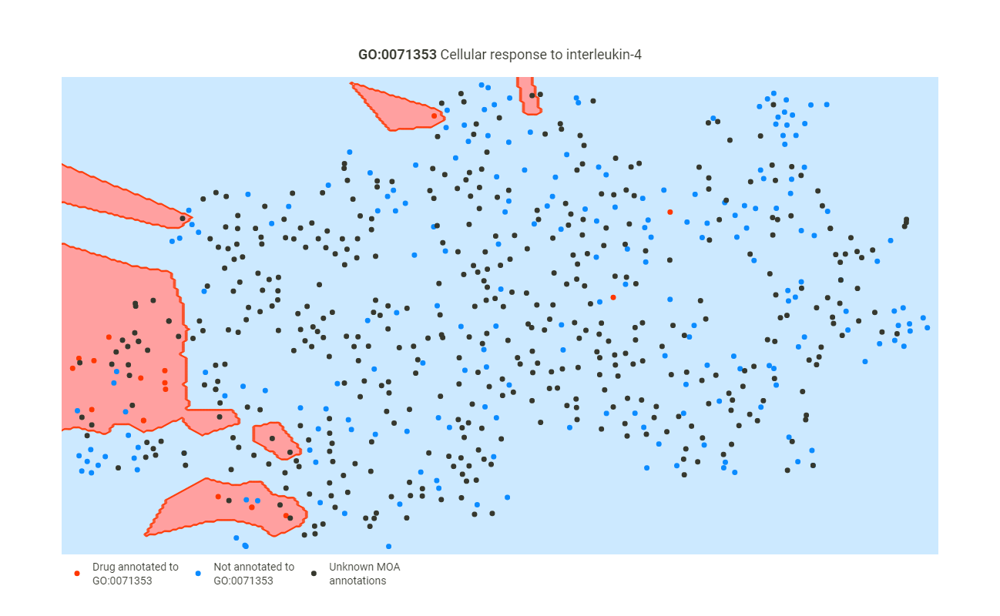

In [222]:
bright_cscale = [[0, "#0b8bff"], [0.5, "#ff3700"],[1, "#36382E"]]
new_cscale = [[0, "#CCE9FF"], [1, "#FFA0A0"]]

trace0 = go.Contour(
        x=xx.flatten(),
        y=yy.flatten(),
        z=voronoiBackground.flatten(),
        hoverinfo="none",
        showscale=False,
        contours=dict(showlines=False),
        colorscale=new_cscale,
        opacity=0.9,
    )
    
trace1 = go.Contour(
    x=xx.flatten(),
    y=yy.flatten(),
    z=voronoiBackground.flatten(),
    showscale=False,
    hoverinfo="none",
    colorscale=new_cscale,
    line=dict(color="#ff3700"),
    )

trace2 = go.Scatter(
    x=df["comp-1"],
    y=df["comp-2"],
    mode="markers",
    text=df["name"].to_numpy(),
    marker=dict(size=7, color=df["y"].to_numpy(int),colorscale=bright_cscale),
    showlegend=False
)

legend1 = go.Scatter(
    x=[None],
    y=[None],
    mode="markers",
    name="Not annotated to<br>"+selected_goterm,
    marker=dict(size=7, color="#0b8bff",symbol='circle'),
)

legend2 = go.Scatter(
    x=[None],
    y=[None],
    mode="markers",
    name="Drug annotated to<br>"+selected_goterm,
    marker=dict(size=7, color="#ff3700",symbol='circle'),
)

legend3 = go.Scatter(
    x=[None],
    y=[None],
    mode="markers",
    name="Unknown MOA<br>annotations",
    marker=dict(size=7, color="#36382E",symbol='circle'),
)

    
layout = go.Layout(
   title=dict(text="<b>"+selected_goterm+"</b> "+go_name,
              x=0.5,
              y=0.92,
              font=dict(size=18),
              xanchor='center',
              yanchor='top'),
    xaxis=dict(ticks="", showticklabels=False, showgrid=False, zeroline=False),
    yaxis=dict(ticks="", showticklabels=False, showgrid=False, zeroline=False),
    yaxis_range=[min(yy.flatten()),max(yy.flatten())],
    xaxis_range=[min(xx.flatten()),max(xx.flatten())],
    legend=dict(x=0, y=0, orientation="h",font=dict(size=14)),
    paper_bgcolor='rgba(0,0,0,0)',
    width=600, height=800,
    font=dict(family='Roboto',color= "#36382E",size=15)
    )
data = [trace0,trace1,trace2,legend2,legend1,legend3]
figure = go.Figure(data=data,layout=layout)




figure